### DEEP NEURAL ENCODER-DECODER MODEL TO RELATE FMRI BRAIN ACTIVITY WITH NATURALISTIC STIMULI

**Student:** Florian David | florian.david@epfl.ch  
**Institution:** Neuro-X, EPFL  
**Last Update:** 23/01/2025  
**Host Lab:** Medical Image Processing Lab (MIP:Lab), EPFL  
**Supervisor:** Michael Chan  

---

#### Abstract

We propose an end-to-end deep neural encoder-decoder model to encode and decode brain activity in response to naturalistic stimuli using functional magnetic resonance imaging (fMRI) data. Leveraging temporally correlated input from consecutive film frames, we employ temporal convolutional layers in our architecture, which effectively allows to bridge the temporal resolution gap between natural movie stimuli and fMRI acquisitions. Our model predicts activity of voxels in and around the visual cortex and performs reconstruction of corresponding visual inputs from neural activity. Finally, we provide insights into brain regions contributing to visual decoding through saliency maps, highlighting the model's potential to advance our understanding of visual processing.

---

#### Content of this notebook

1. Pipeline to load the data, train a model, and test it.
2. Pipeline to preprocess the data and store it into train/val/test sets.

# 1. Pipeline to load the data, train a model, and test it.

Assume the data is already preprocessed and stored as described in 2.

In [1]:
### necessary imports ###

import os
os.environ["CUDA_VISIBLE_DEVICES"] = "1,2,3"

from dataset import *
from models import *
from visualisation import *

In [2]:
### data loading ###

dataset_ID = 6661 # ID of a specific dataset. 6661 refer to preprocessed data with a mask of shape (4609,). 6660 refers to preprocessed data with a mask of shape (15364,)
mask_size = 4609 # number of voxels in the preprocessed fMRI data. either 4609 or 15364
trainset, valset, testset = get_dataset(dataset_ID, mask_size) # data are loaded into dictionaries

print_dict_tree(trainset)
# print_dict_tree(valset)
# print_dict_tree(testset)

fMRIs (shape: (4321, 4609))
videos (shape: (4321, 3, 112, 112, 32))


In [3]:
### model training ###

# Training parameters
train_input = trainset['videos']
train_label = trainset['fMRIs']
model = EncoderDecoder(mask_size)
num_epochs = 12
lr = 1e-4
encoder_weight = 0.5
criterion = ED_Loss(encoder_weight = encoder_weight)
optimizer = torch.optim.Adam(model.parameters(), lr=lr)
batch_size = 16
device = torch.device("cuda:2" if torch.cuda.is_available() else "cpu")
save_model_as = 'encoder_decoder_4609_11'
pretrained_decoder = None
start_epoch = 1
start_loss = None
model_to_train = 'encoder_decoder'
display_plots = True

# Training loop
# model, history = train_model(train_input, train_label, model, num_epochs, lr, criterion, optimizer, batch_size, device, save_model_as, pretrained_decoder, start_epoch, start_loss, model_to_train, display_plots)
# print_dict_tree(history)

Start testing:
### Testing encoder_decoder on inputs of shape ['TR', 3, 112, 112, 32] over 14 videos ###
### Sintel: (111, 4609) ###


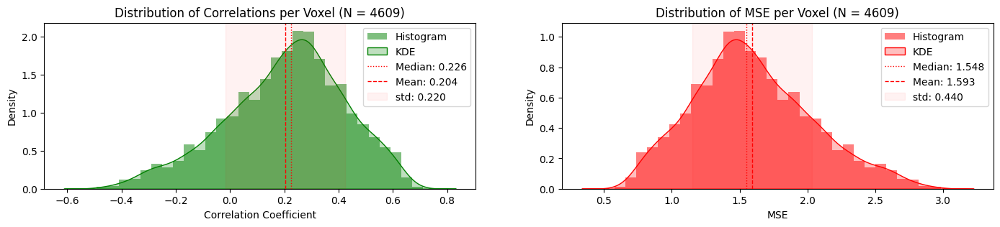

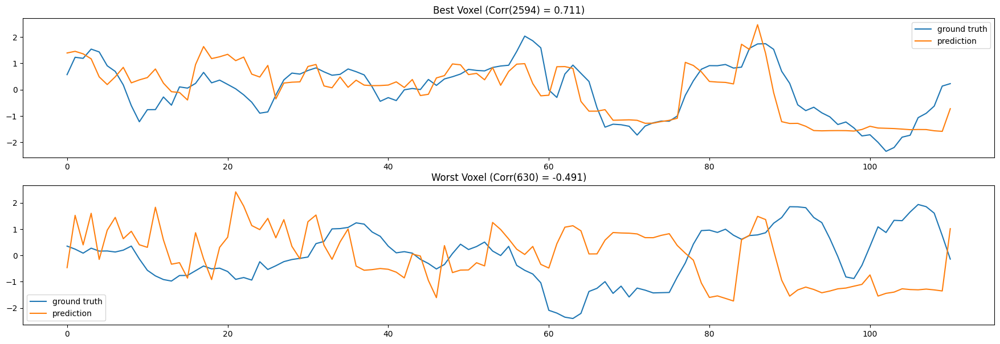

### Payload: (155, 4609) ###


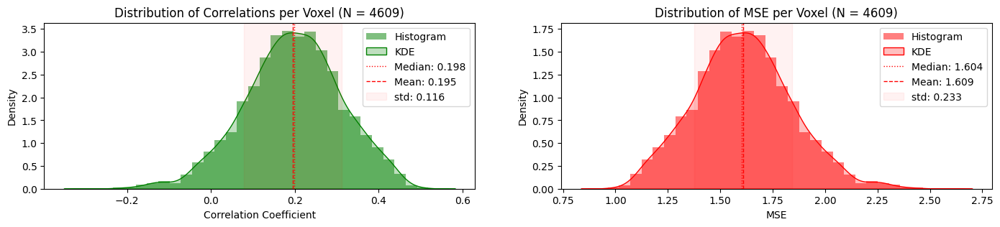

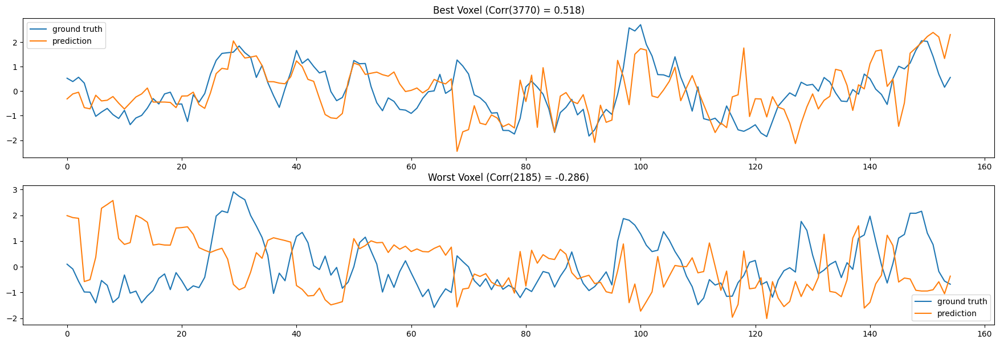

### TearsOfSteel: (91, 4609) ###


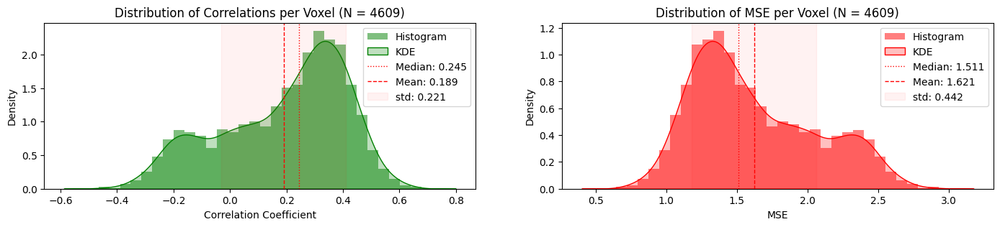

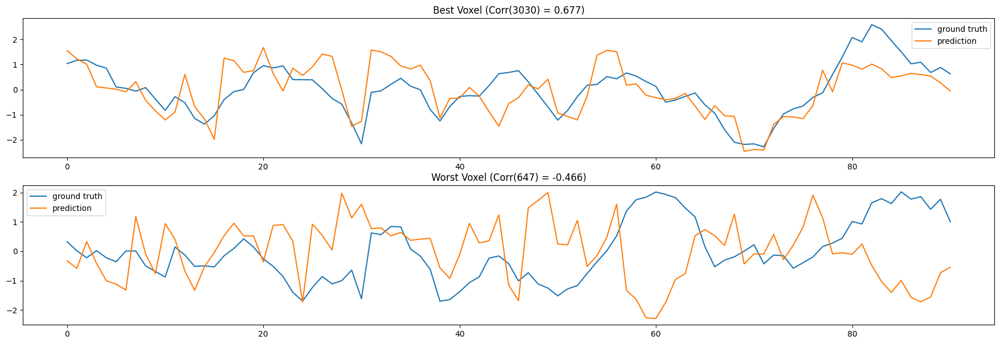

### Superhero: (158, 4609) ###


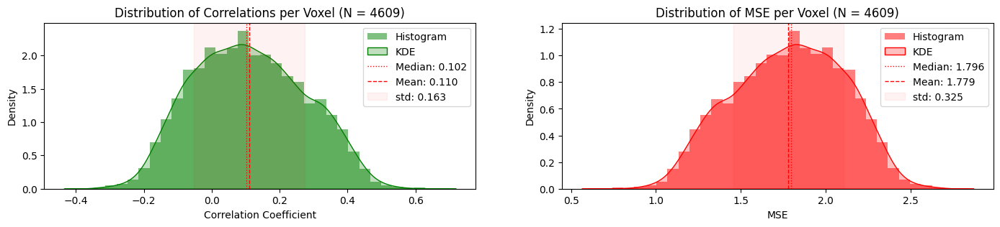

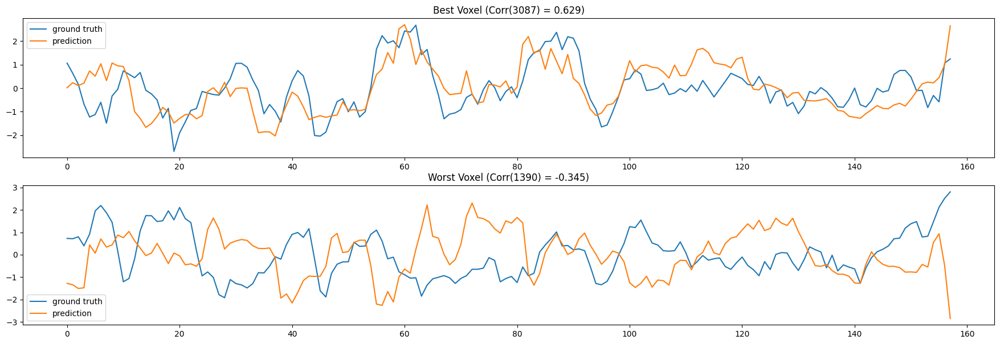

### BigBuckBunny: (76, 4609) ###


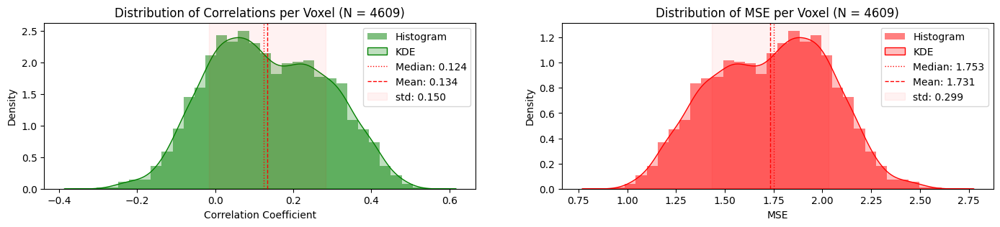

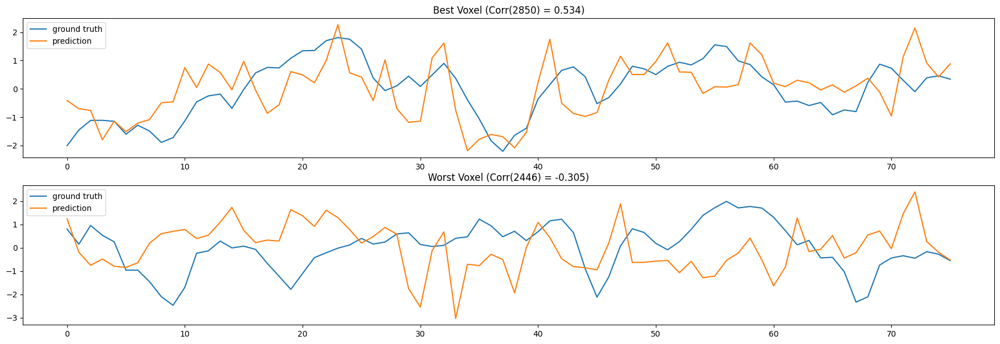

### FirstBite: (92, 4609) ###


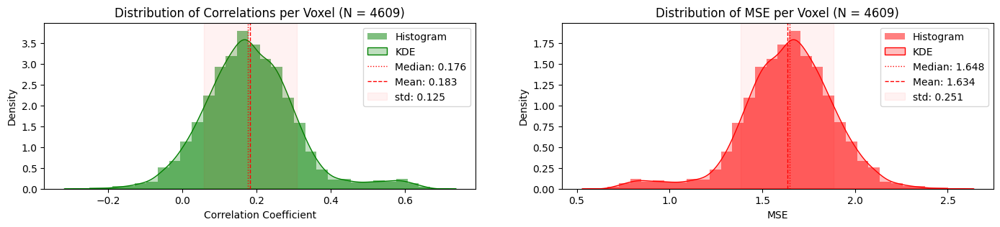

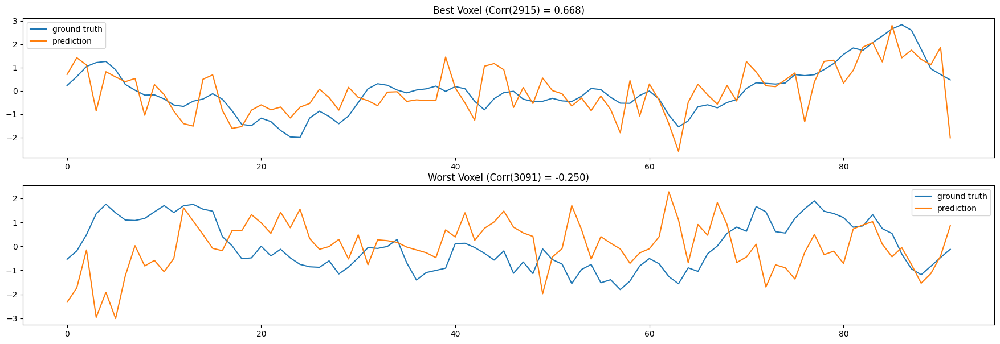

### BetweenViewings: (125, 4609) ###


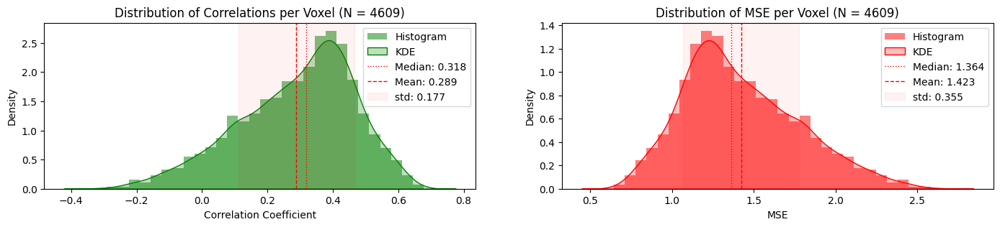

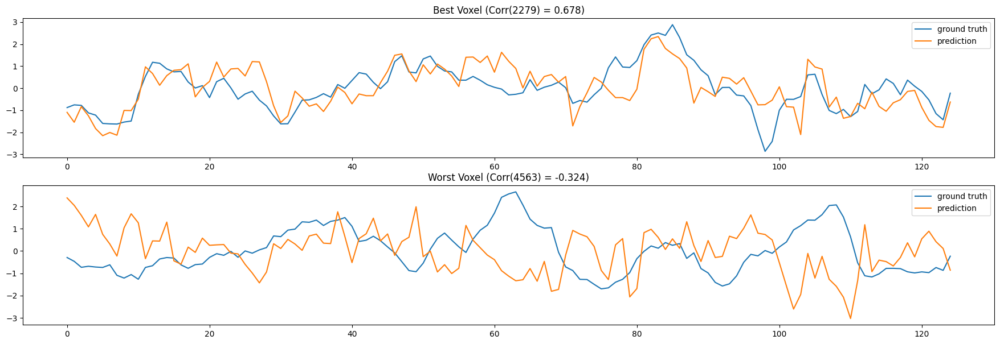

### AfterTheRain: (77, 4609) ###


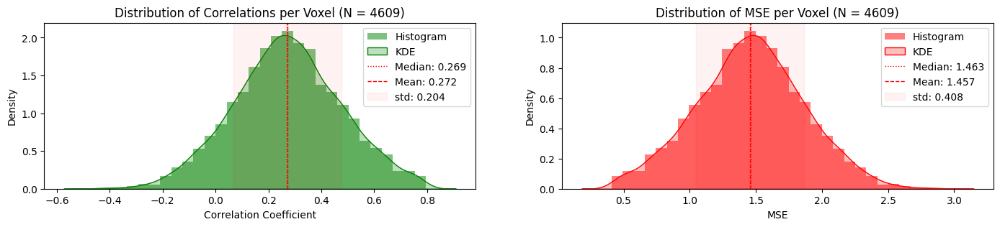

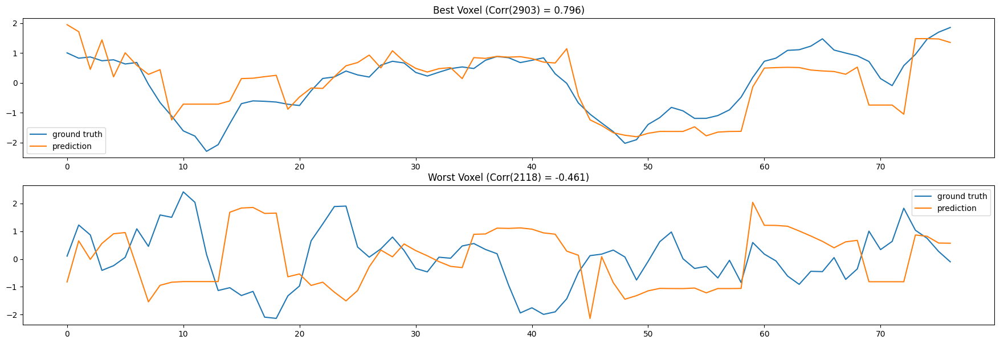

### TheSecretNumber: (121, 4609) ###


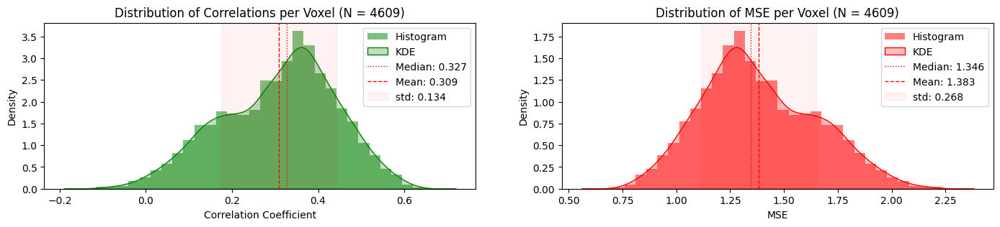

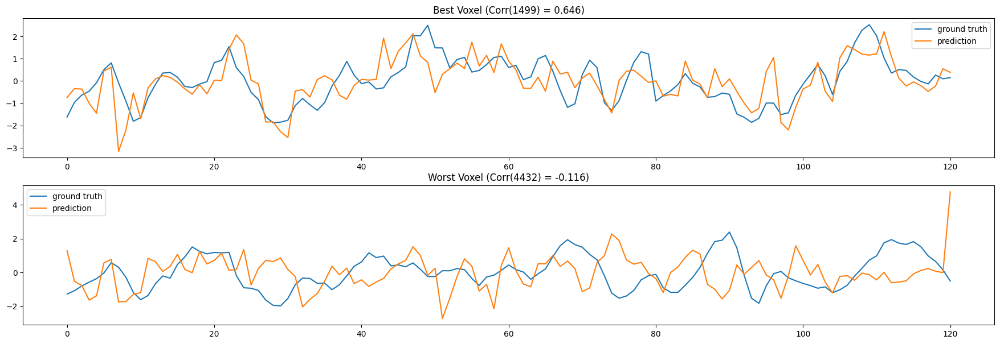

### Chatter: (63, 4609) ###


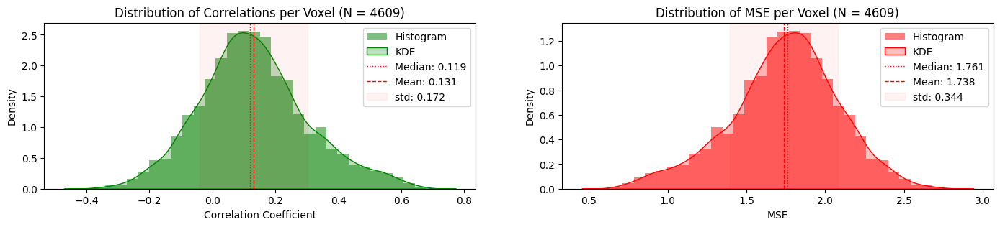

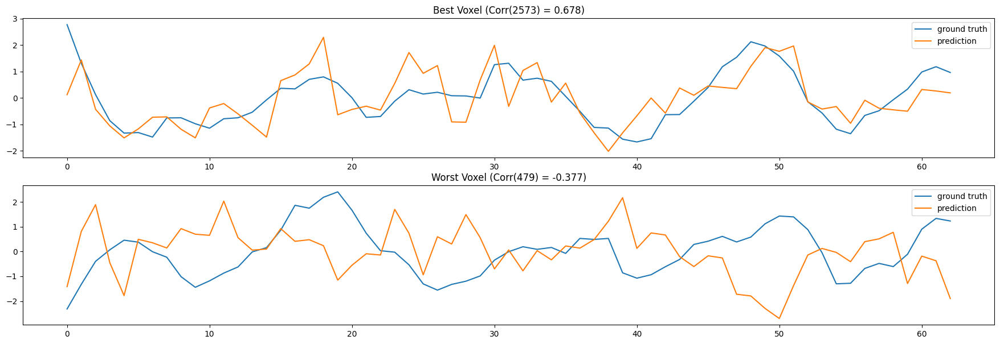

### Spaceman: (124, 4609) ###


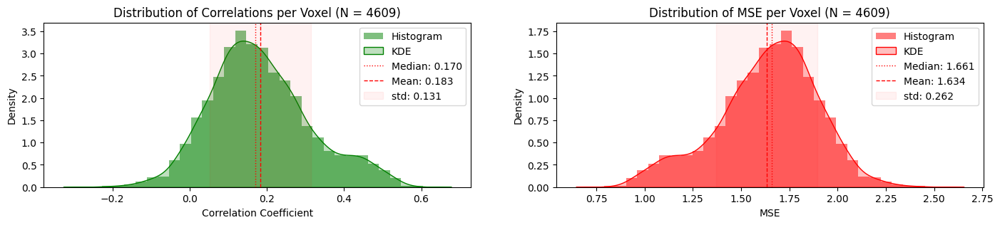

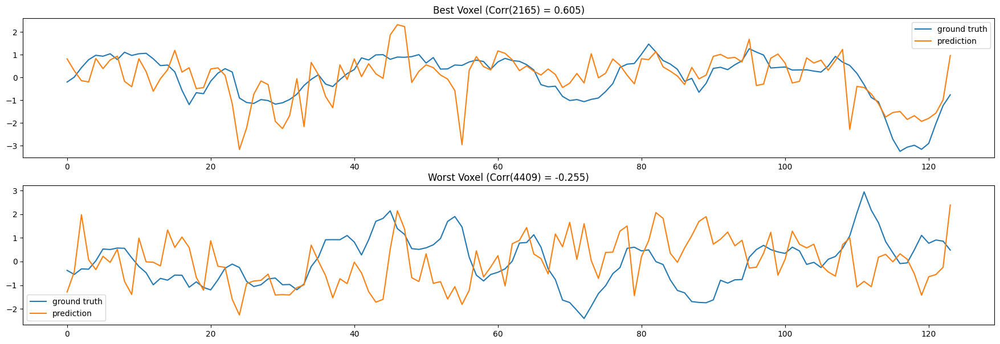

### LessonLearned: (103, 4609) ###


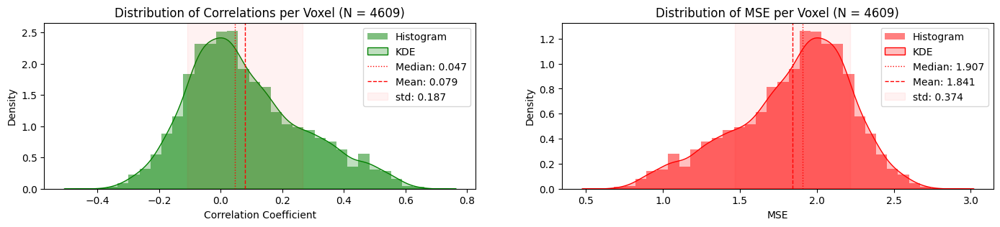

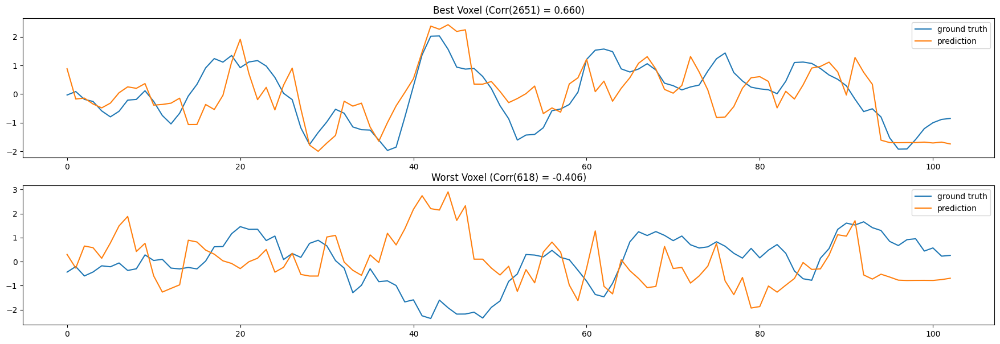

### YouAgain: (613, 4609) ###


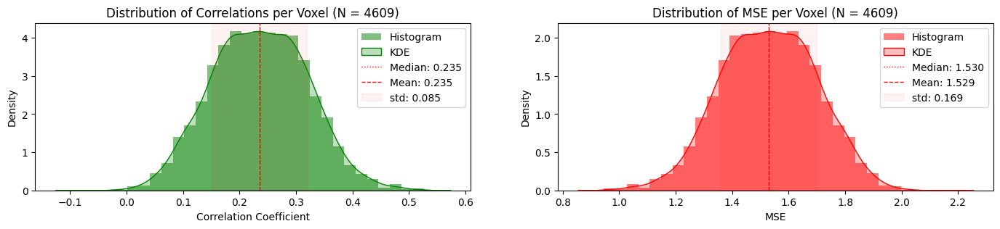

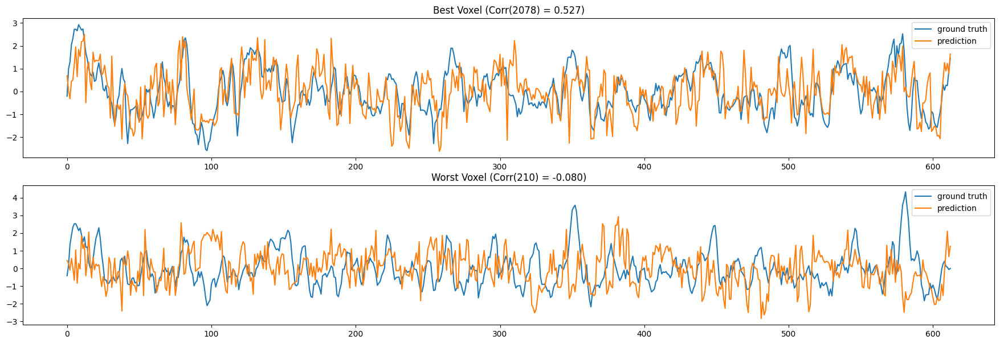

### ToClaireFromSonny: (62, 4609) ###


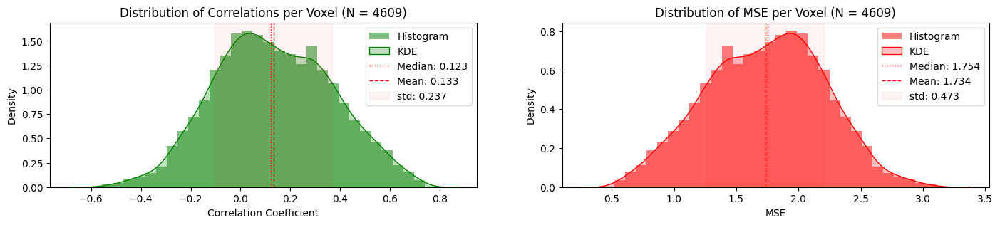

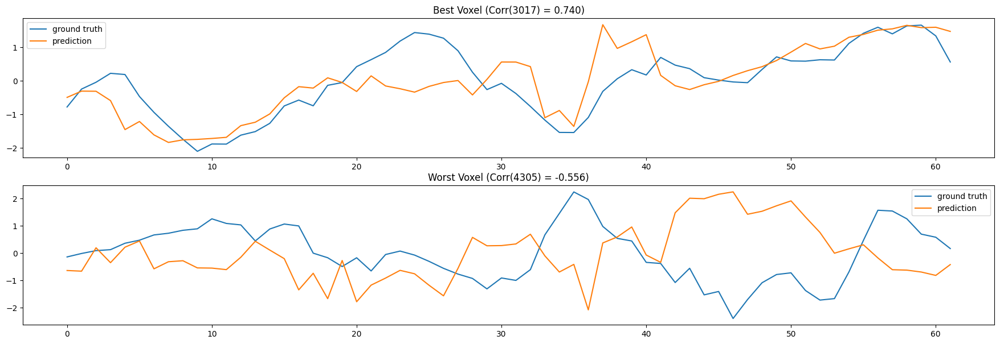

### all: (1971, 4609) ###


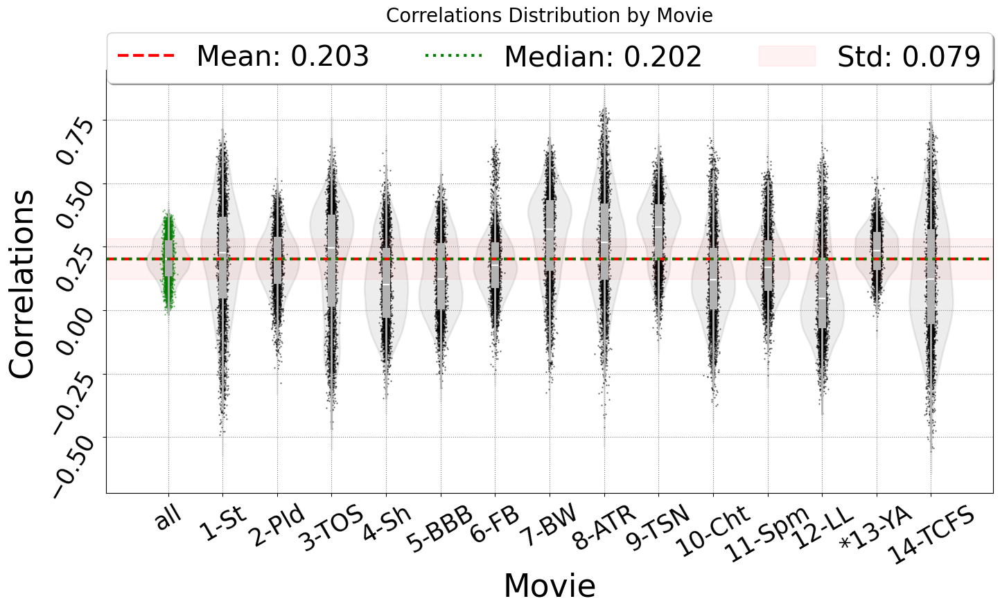

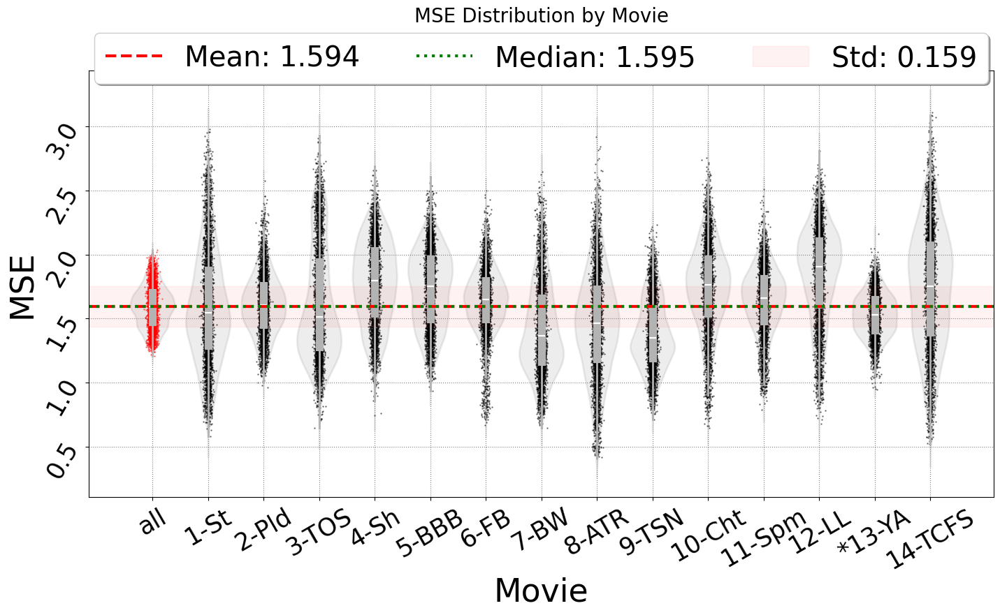

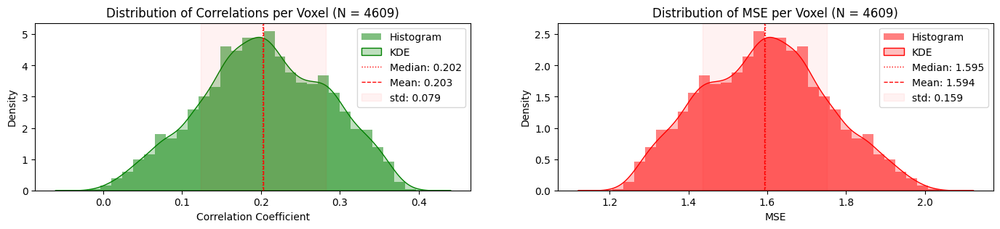

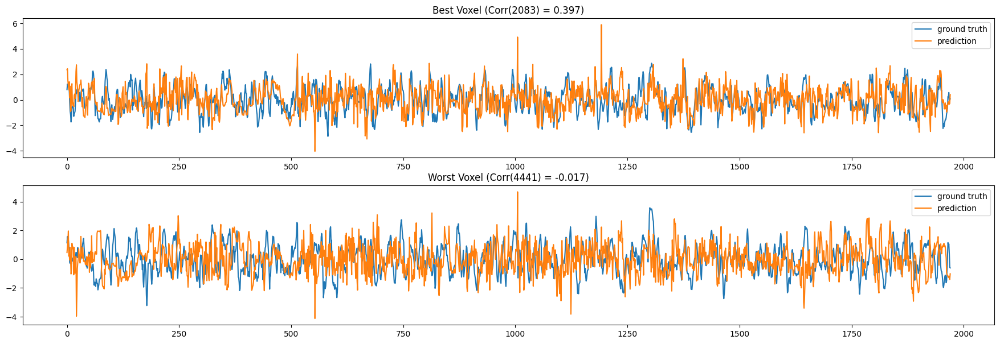

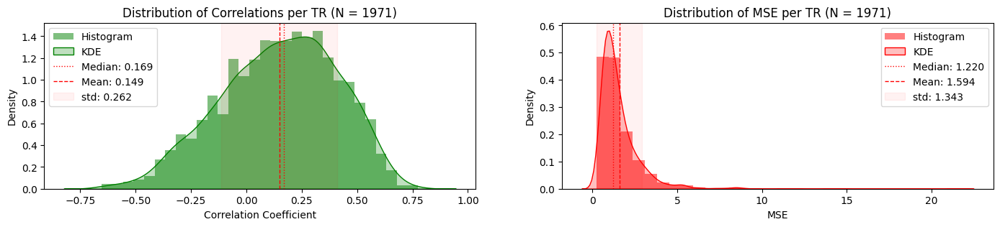

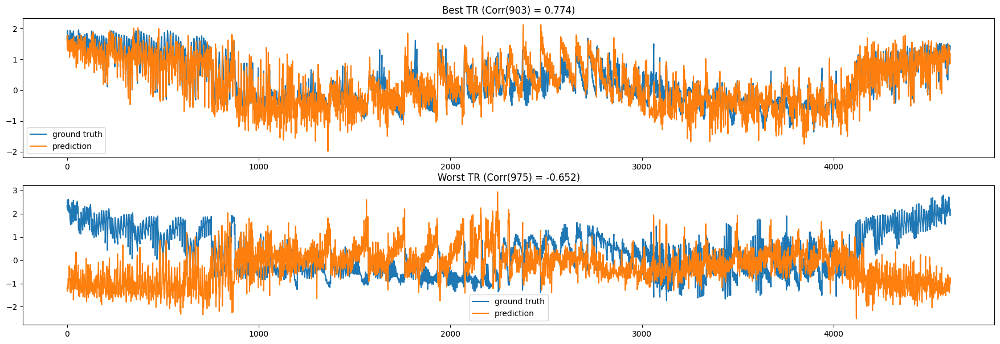

/home/fadavid/Video_dataset/visualisation.py:441: UserWarning: The given NumPy array is not writeable, and PyTorch does not support non-writeable tensors. This means you can write to the underlying (supposedly non-writeable) NumPy array using the tensor. You may want to copy the array to protect its data or make it writeable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at  ../torch/csrc/utils/tensor_numpy.cpp:189.)
  ssim(torch.from_numpy(video[i]).unsqueeze(0), torch.from_numpy(prediction[i]).unsqueeze(0), data_range=1, size_average=True).item()


### Sintel (111) ###


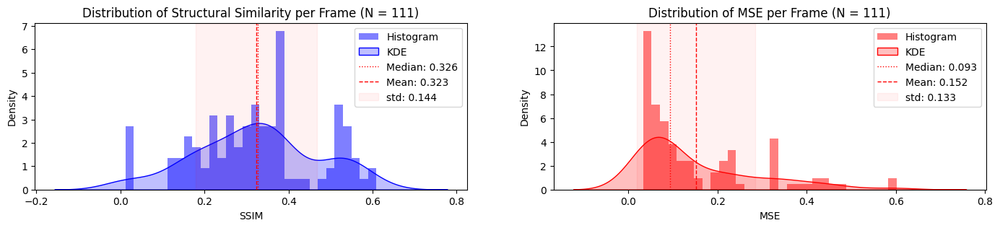

Display 37 frames: [  0   3   6   9  12  15  18  21  24  27  30  33  36  39  42  45  48  51
  54  57  60  63  66  69  72  75  78  81  84  87  90  93  96  99 102 105
 108]


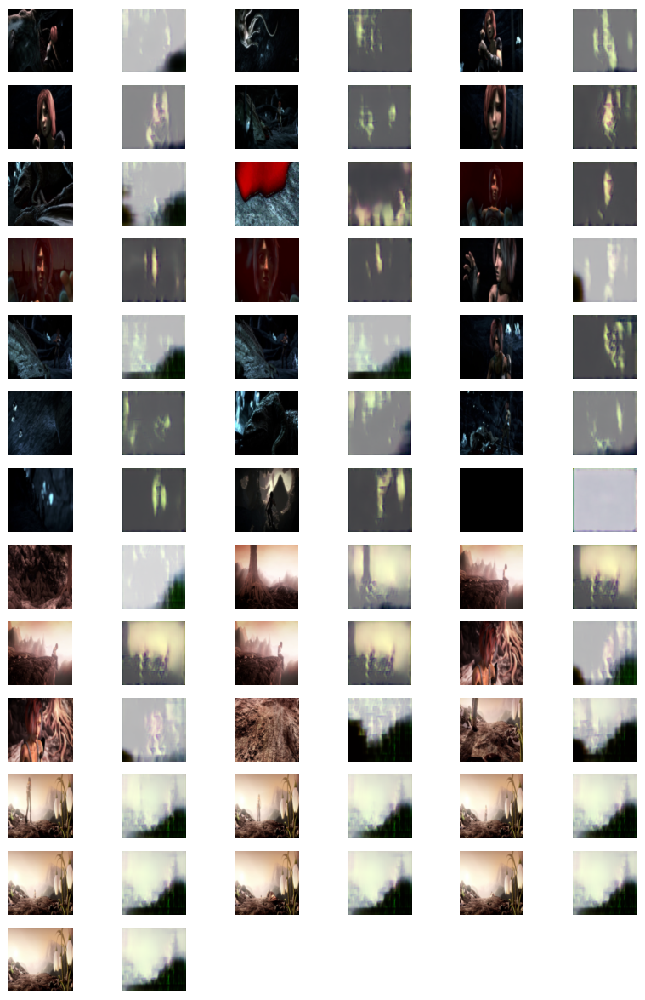

### Payload (155) ###


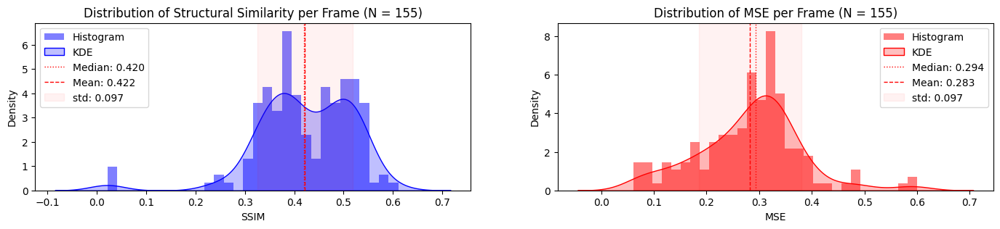

Display 52 frames: [  0   3   6   9  12  15  18  21  24  27  30  33  36  39  42  45  48  51
  54  57  60  63  66  69  72  75  78  81  84  87  90  93  96  99 102 105
 108 111 114 117 120 123 126 129 132 135 138 141 144 147 150 153]


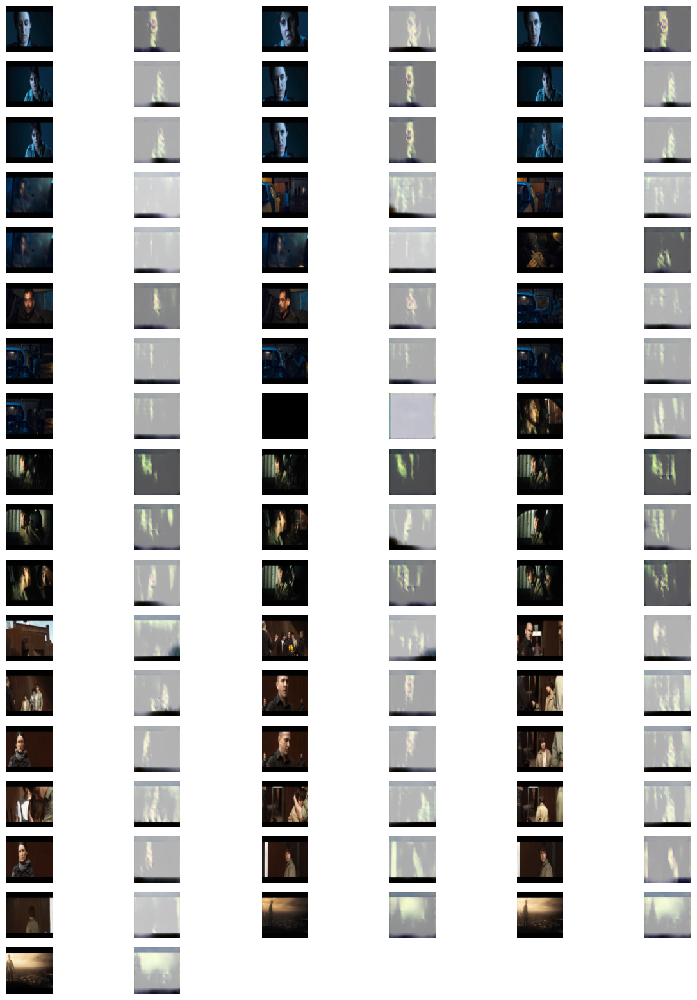

### TearsOfSteel (91) ###


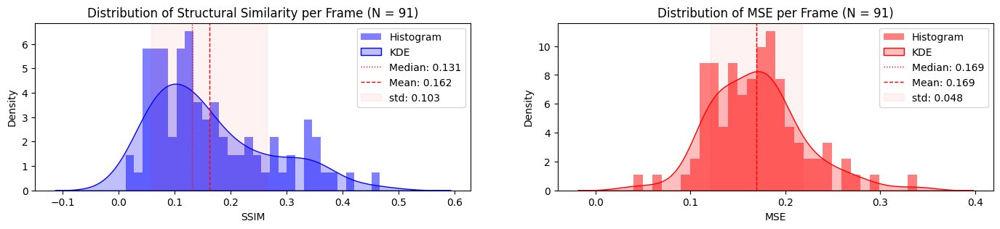

Display 31 frames: [ 0  3  6  9 12 15 18 21 24 27 30 33 36 39 42 45 48 51 54 57 60 63 66 69
 72 75 78 81 84 87 90]


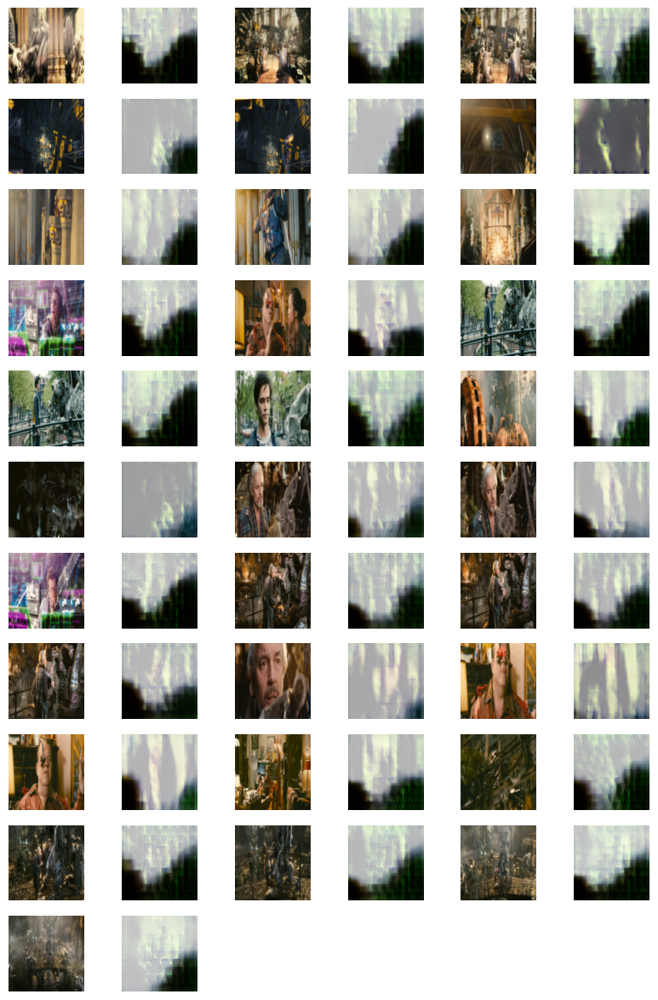

### Superhero (158) ###


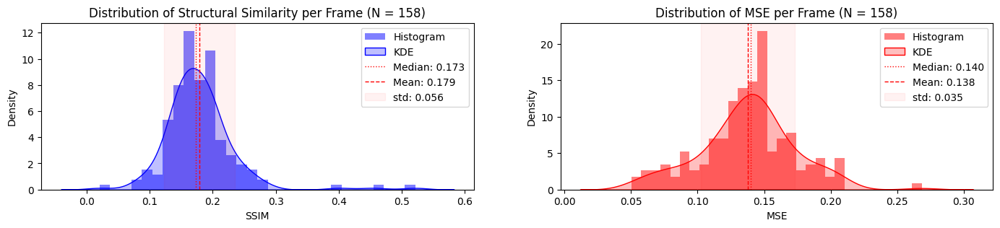

Display 53 frames: [  0   3   6   9  12  15  18  21  24  27  30  33  36  39  42  45  48  51
  54  57  60  63  66  69  72  75  78  81  84  87  90  93  96  99 102 105
 108 111 114 117 120 123 126 129 132 135 138 141 144 147 150 153 156]


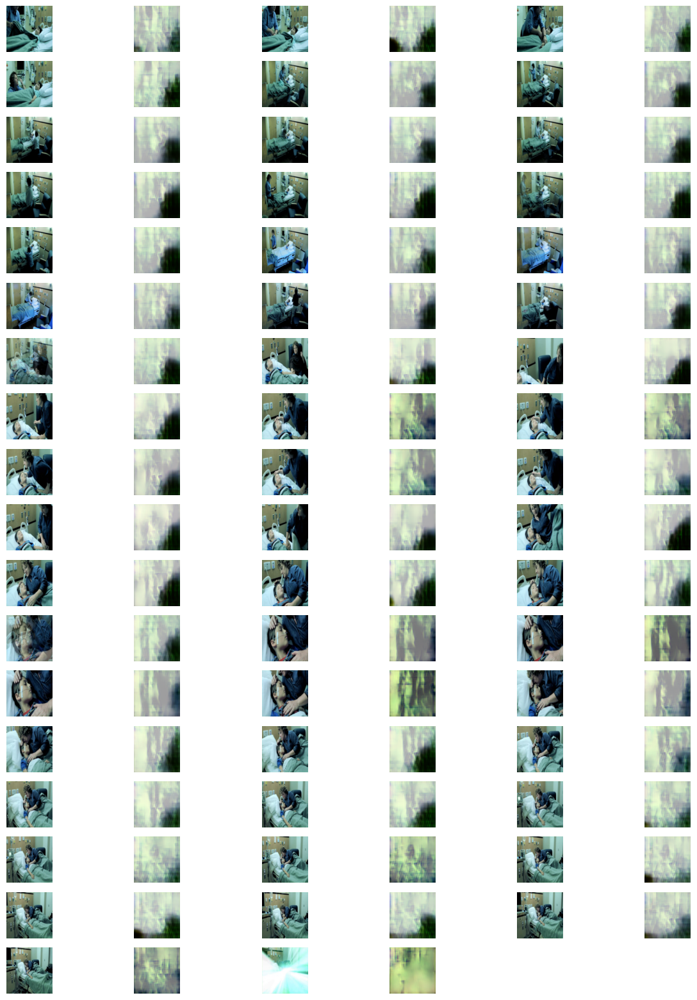

### BigBuckBunny (76) ###


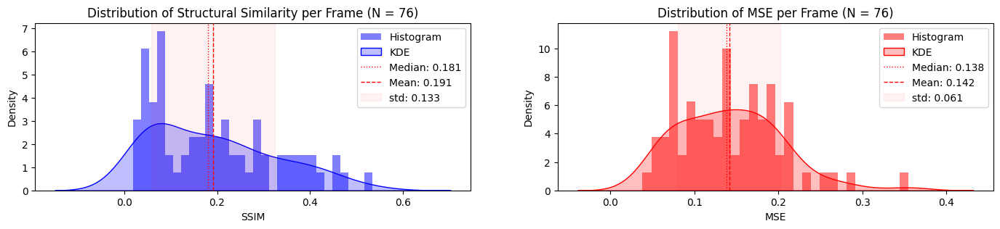

Display 26 frames: [ 0  3  6  9 12 15 18 21 24 27 30 33 36 39 42 45 48 51 54 57 60 63 66 69
 72 75]


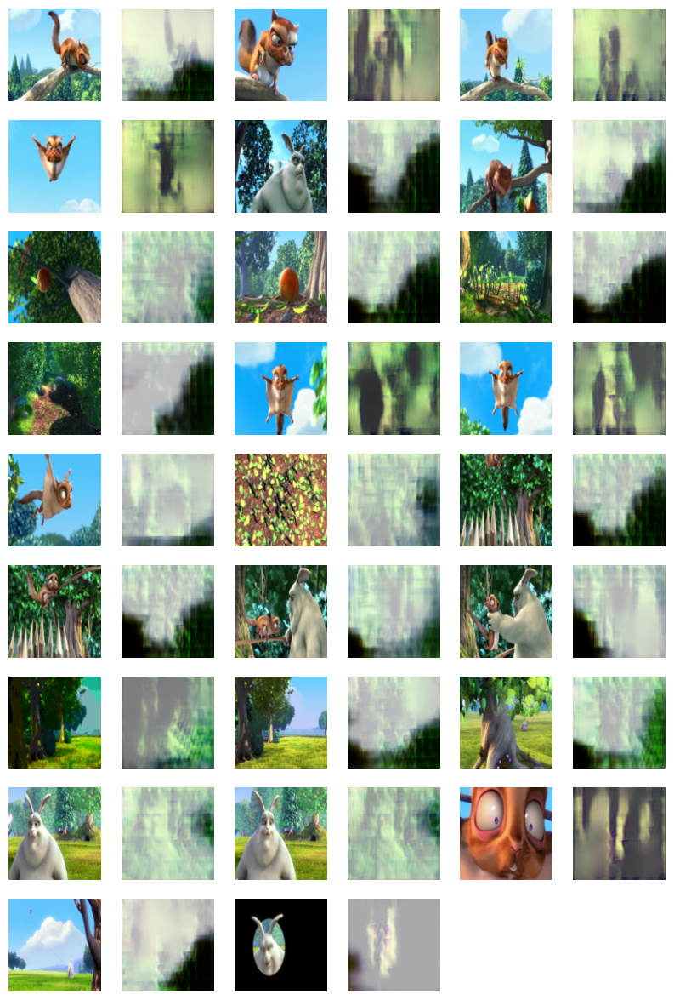

### FirstBite (92) ###


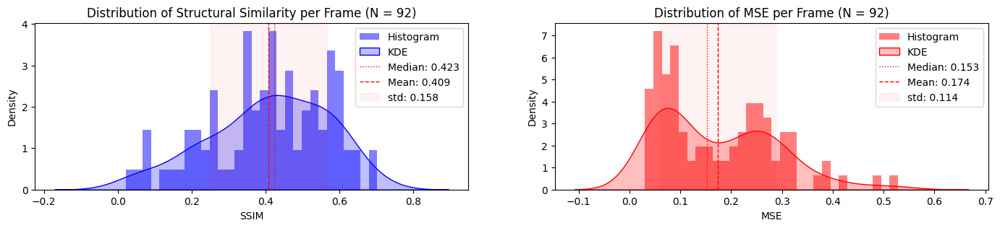

Display 31 frames: [ 0  3  6  9 12 15 18 21 24 27 30 33 36 39 42 45 48 51 54 57 60 63 66 69
 72 75 78 81 84 87 90]


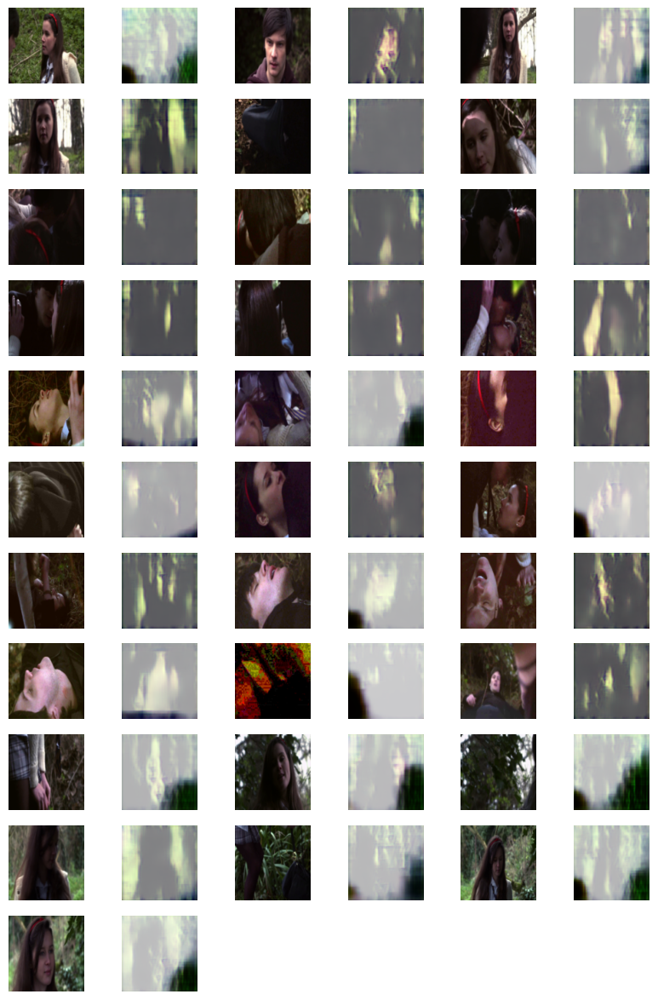

### BetweenViewings (125) ###


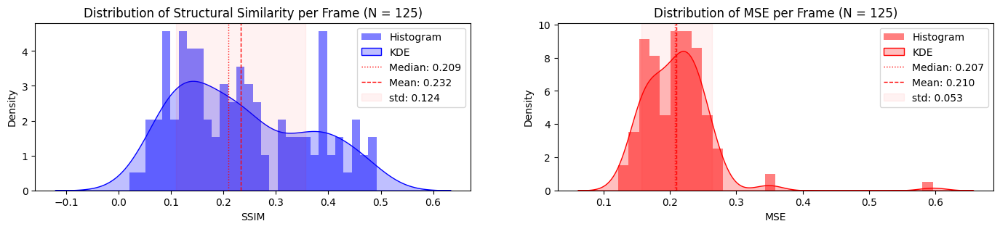

Display 42 frames: [  0   3   6   9  12  15  18  21  24  27  30  33  36  39  42  45  48  51
  54  57  60  63  66  69  72  75  78  81  84  87  90  93  96  99 102 105
 108 111 114 117 120 123]


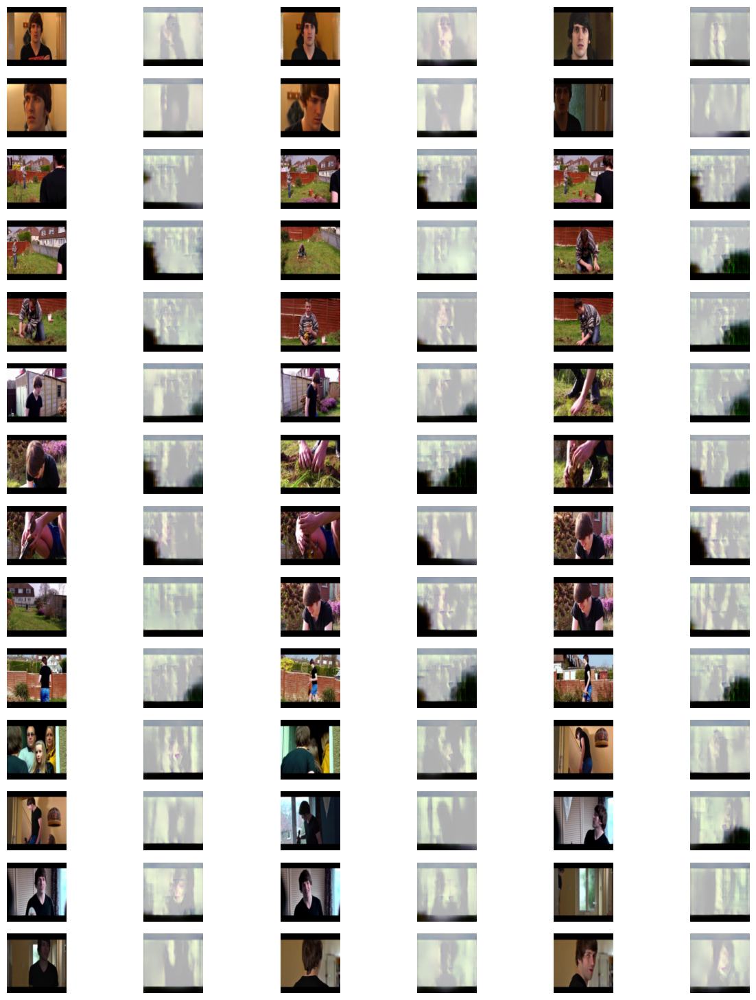

### AfterTheRain (77) ###


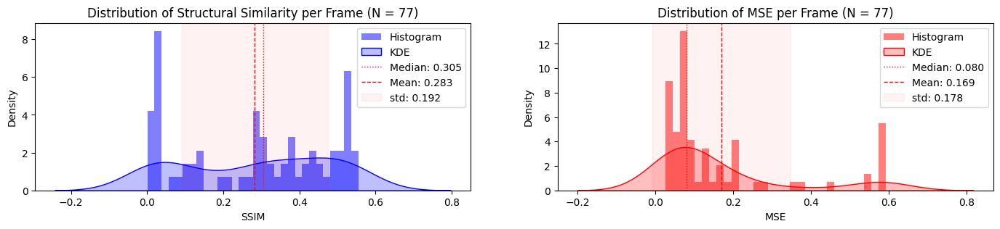

Display 26 frames: [ 0  3  6  9 12 15 18 21 24 27 30 33 36 39 42 45 48 51 54 57 60 63 66 69
 72 75]


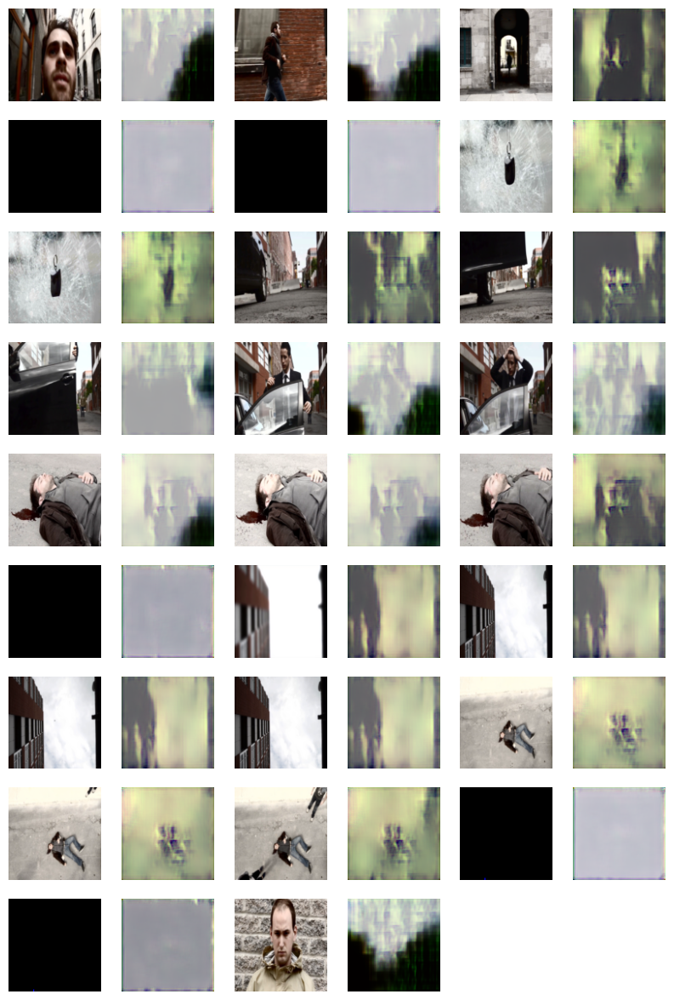

### TheSecretNumber (121) ###


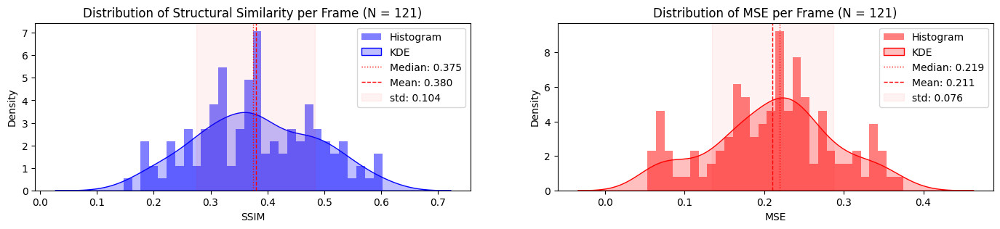

Display 41 frames: [  0   3   6   9  12  15  18  21  24  27  30  33  36  39  42  45  48  51
  54  57  60  63  66  69  72  75  78  81  84  87  90  93  96  99 102 105
 108 111 114 117 120]


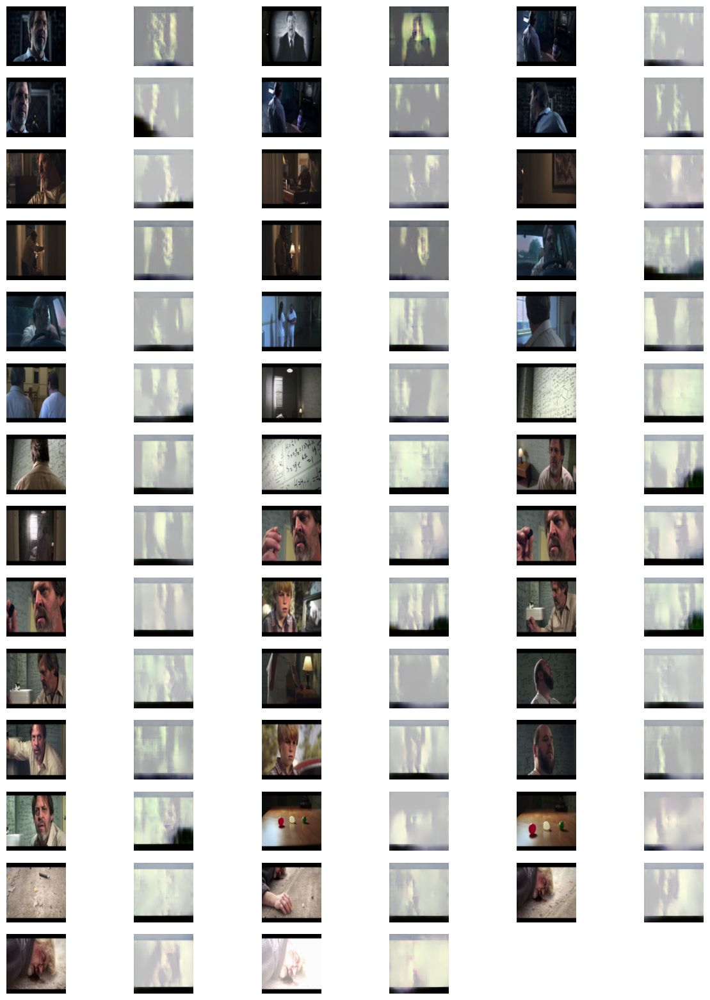

### Chatter (63) ###


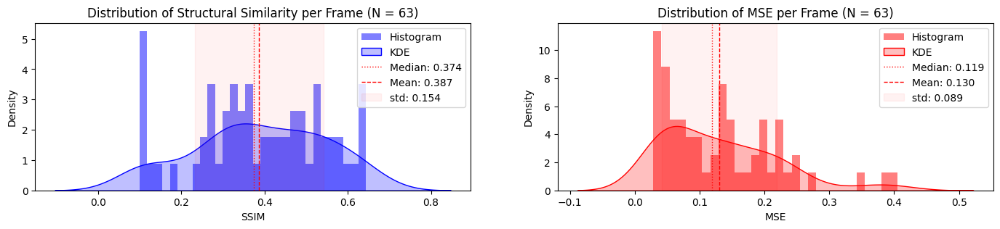

Display 21 frames: [ 0  3  6  9 12 15 18 21 24 27 30 33 36 39 42 45 48 51 54 57 60]


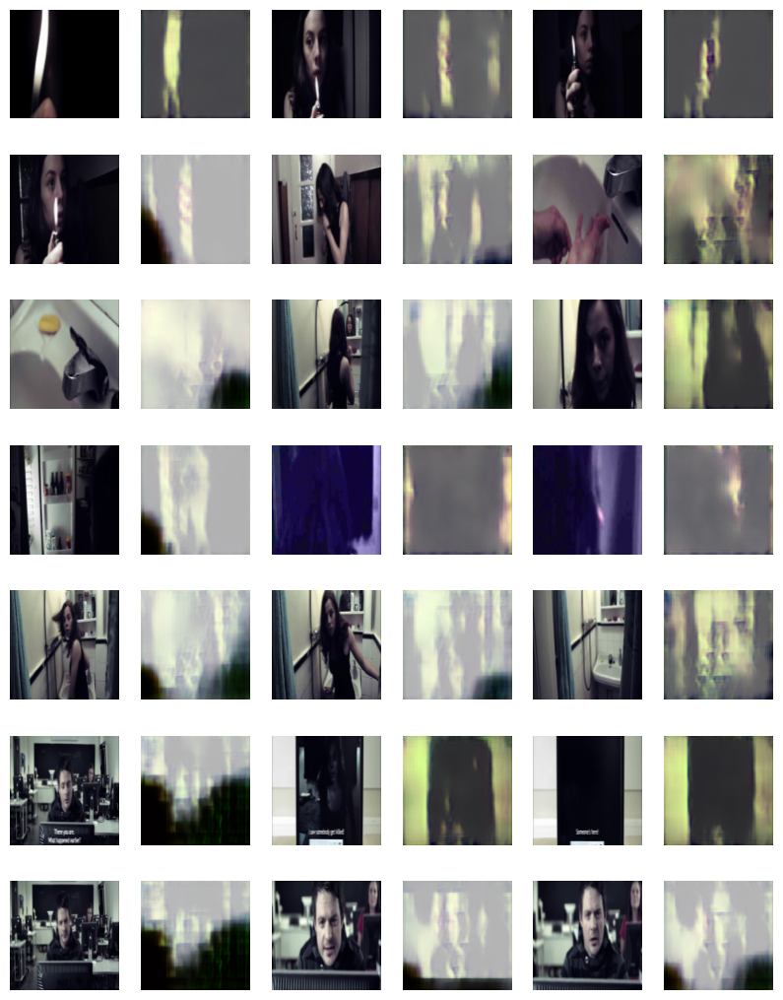

### Spaceman (124) ###


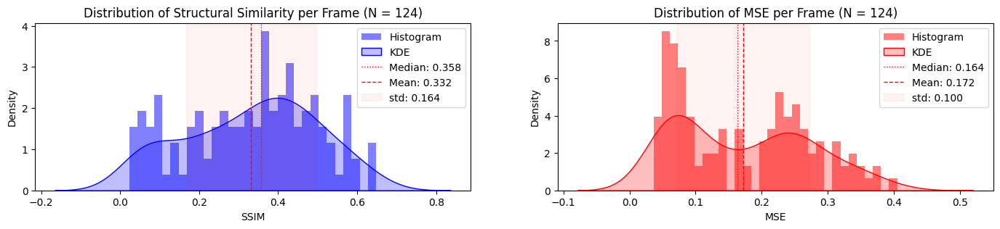

Display 42 frames: [  0   3   6   9  12  15  18  21  24  27  30  33  36  39  42  45  48  51
  54  57  60  63  66  69  72  75  78  81  84  87  90  93  96  99 102 105
 108 111 114 117 120 123]


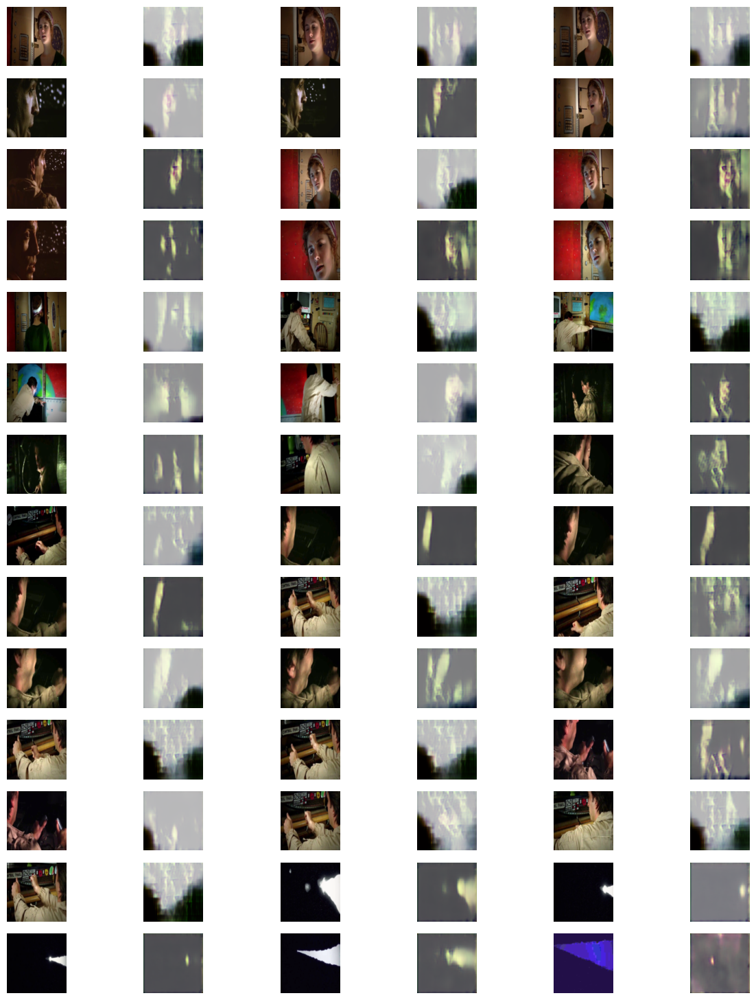

### LessonLearned (103) ###


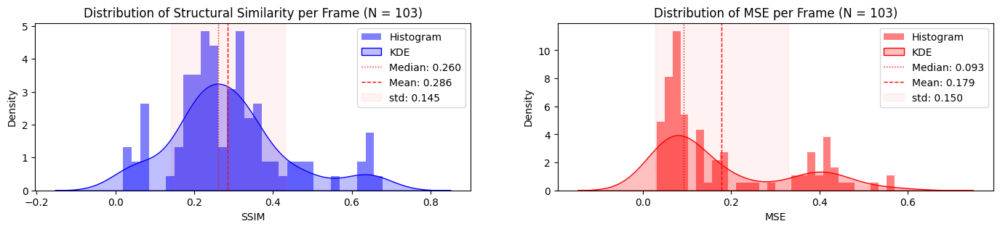

Display 35 frames: [  0   3   6   9  12  15  18  21  24  27  30  33  36  39  42  45  48  51
  54  57  60  63  66  69  72  75  78  81  84  87  90  93  96  99 102]


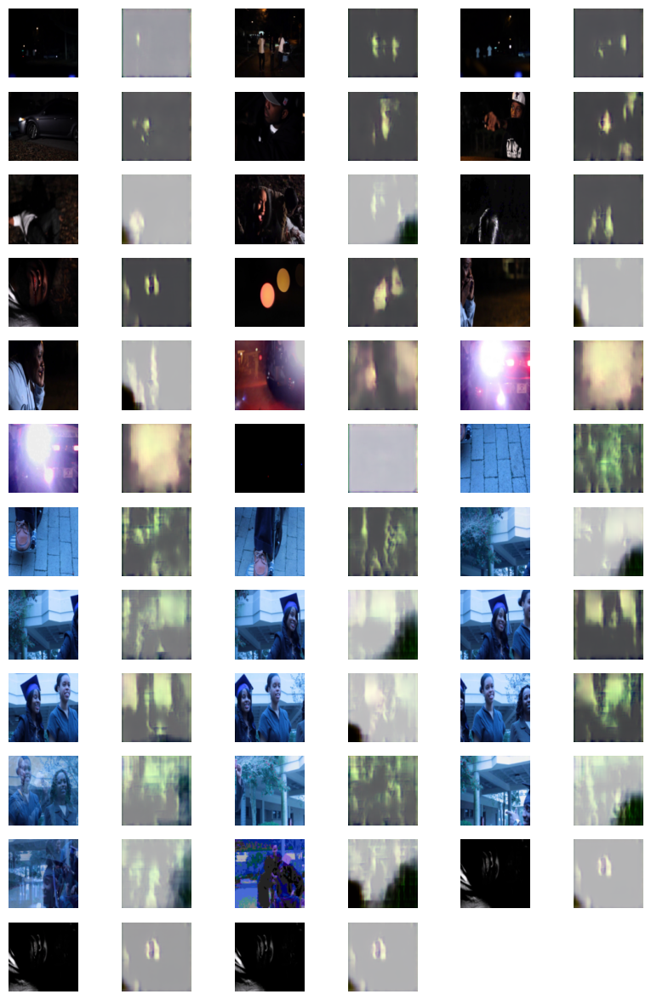

### YouAgain (613) ###


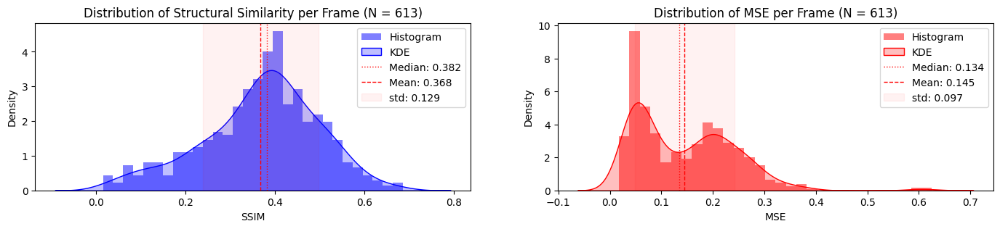

Display 41 frames: [  0  15  30  45  60  75  90 105 120 135 150 165 180 195 210 225 240 255
 270 285 300 315 330 345 360 375 390 405 420 435 450 465 480 495 510 525
 540 555 570 585 600]


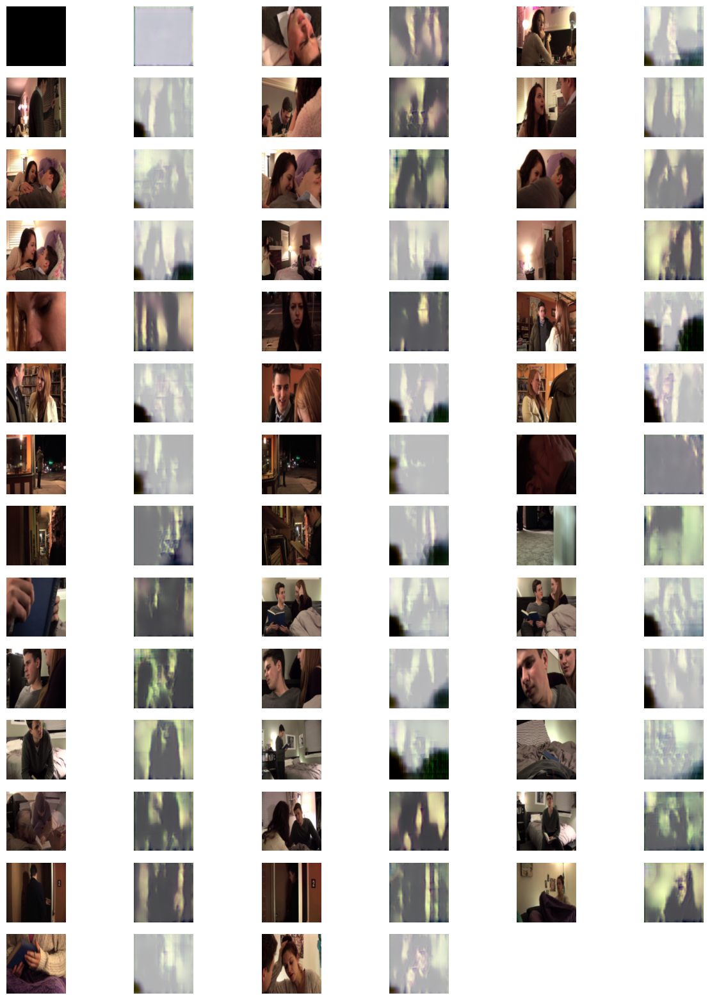

### ToClaireFromSonny (62) ###


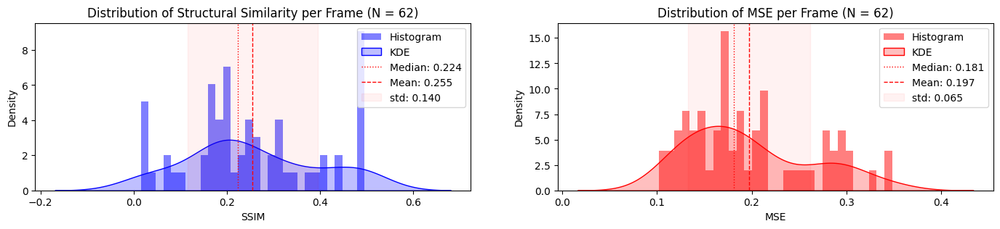

Display 21 frames: [ 0  3  6  9 12 15 18 21 24 27 30 33 36 39 42 45 48 51 54 57 60]


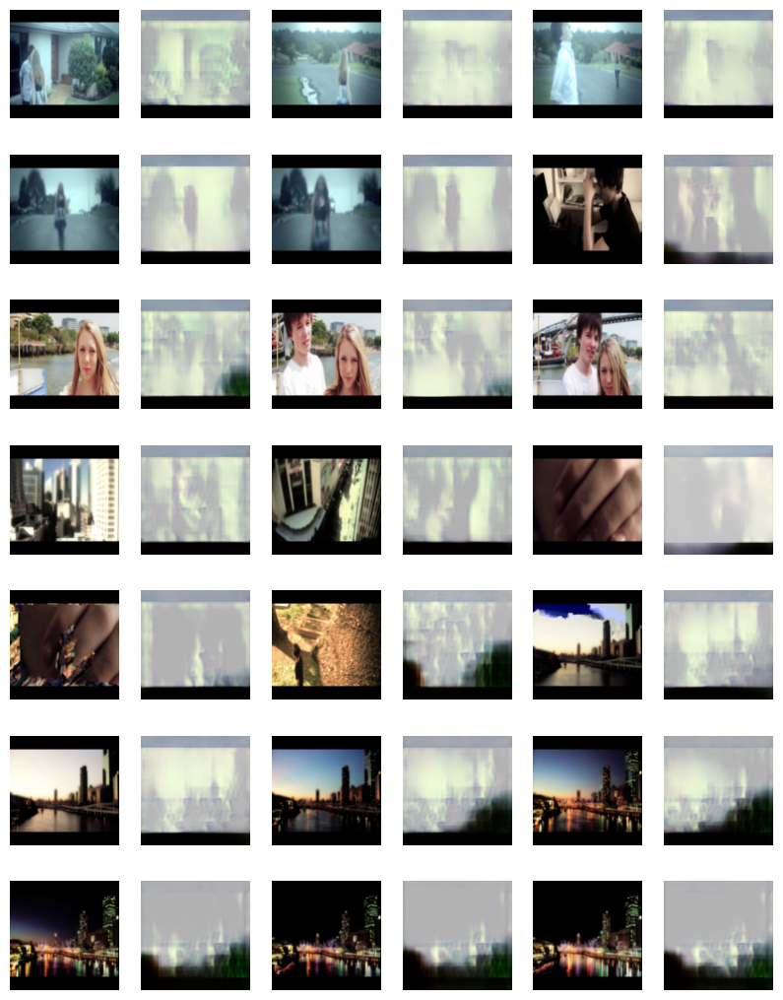

### all (1971) ###


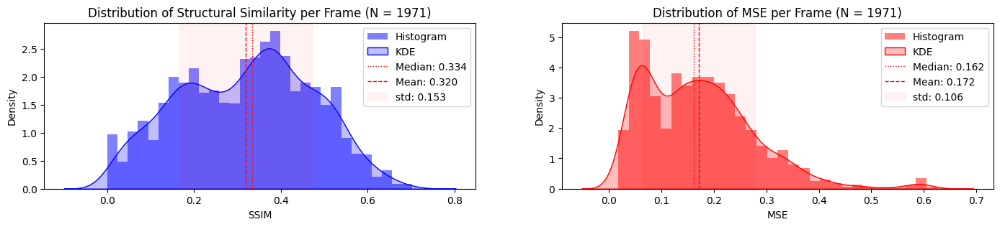

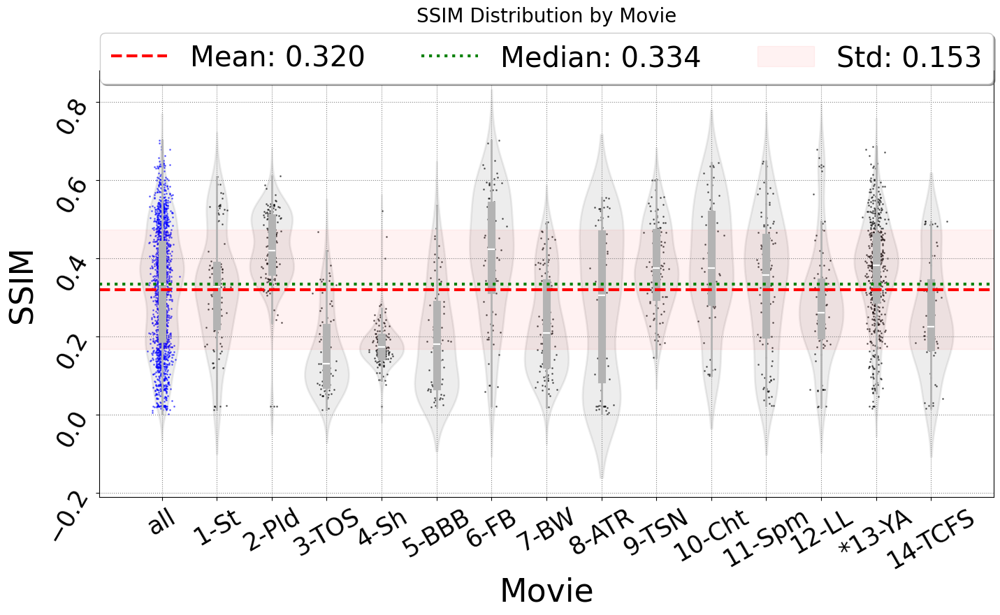

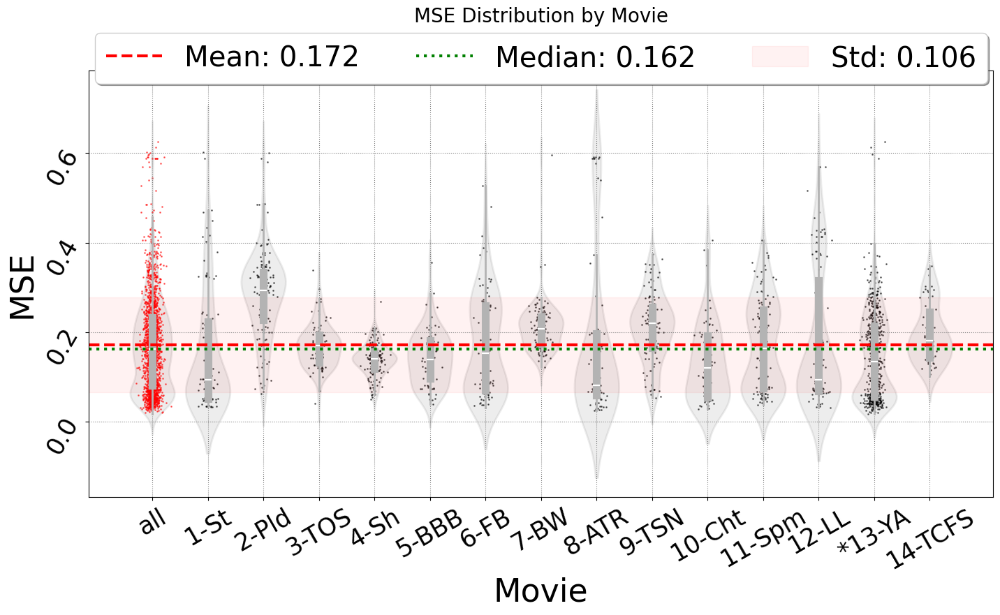

### Saliency Mapping to Anatomical Regions ###
Top 20% saliency values are above 0.091
Region           | Number of voxels    | Number of best saliencies
Calcarine        | 610                 | 191
Lingual          | 525                 | 62
Occipital_Sup    | 345                 | 112
Occipital_Mid    | 1464                | 251
Occipital_Inf    | 204                 | 77
Fusiform         | 727                 | 115
Temporal_Mid     | 474                 | 37
Temporal_Inf     | 153                 | 40
Other            | 64                  | 27

Region           | Total % of voxels   | % of best saliencies
Calcarine        | 13.4%               | 20.7%
Lingual          | 11.5%               | 6.7%
Occipital_Sup    | 7.6%                | 12.2%
Occipital_Mid    | 32.1%               | 27.2%
Occipital_Inf    | 4.5%                | 8.4%
Fusiform         | 15.9%               | 12.5%
Temporal_Mid     | 10.4%               | 4.0%
Temporal_Inf     | 3.4%                | 4.3%
Other      

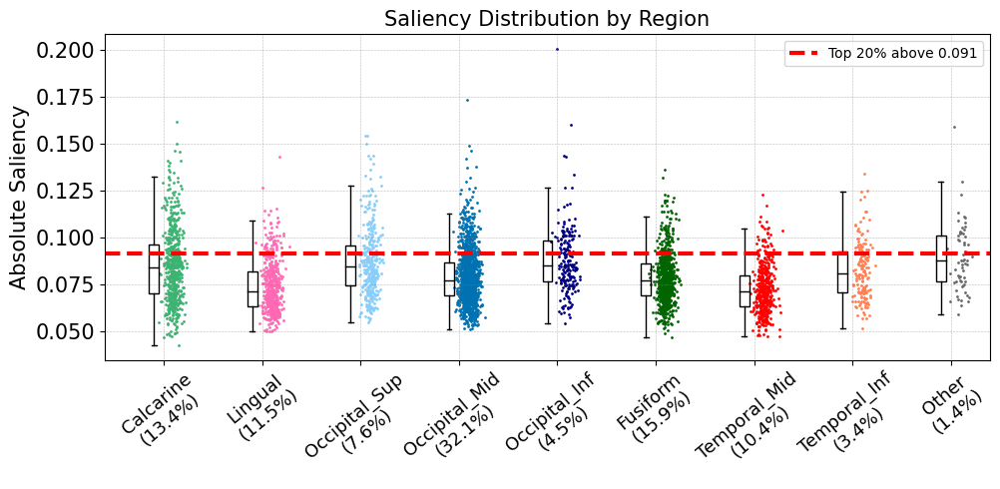

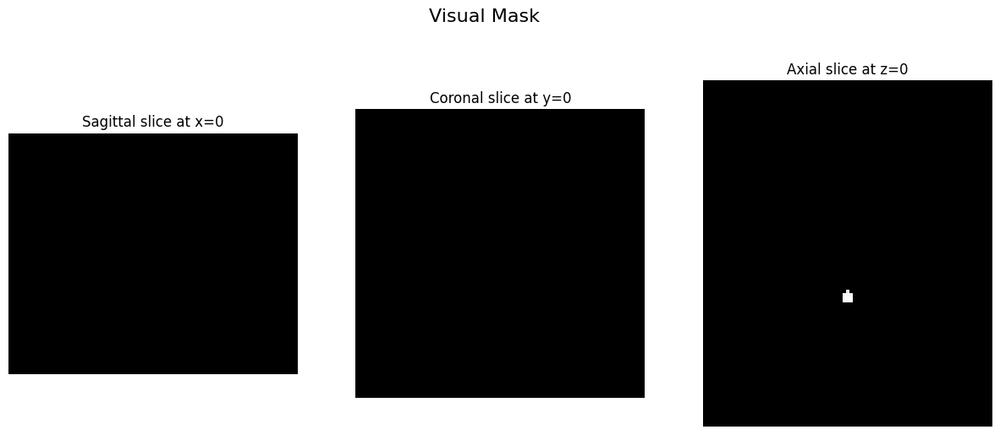

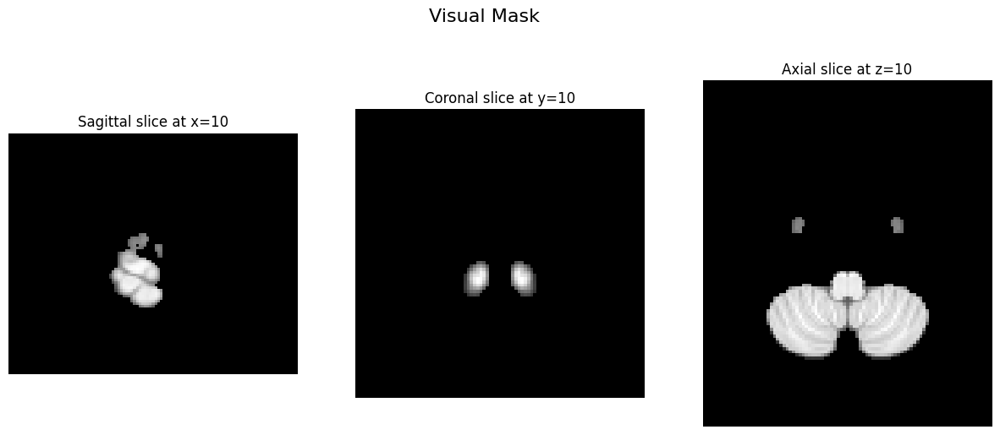

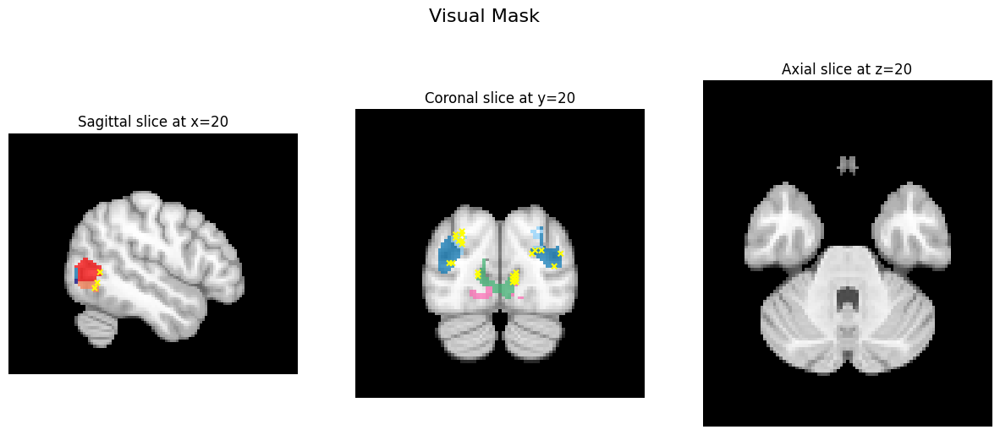

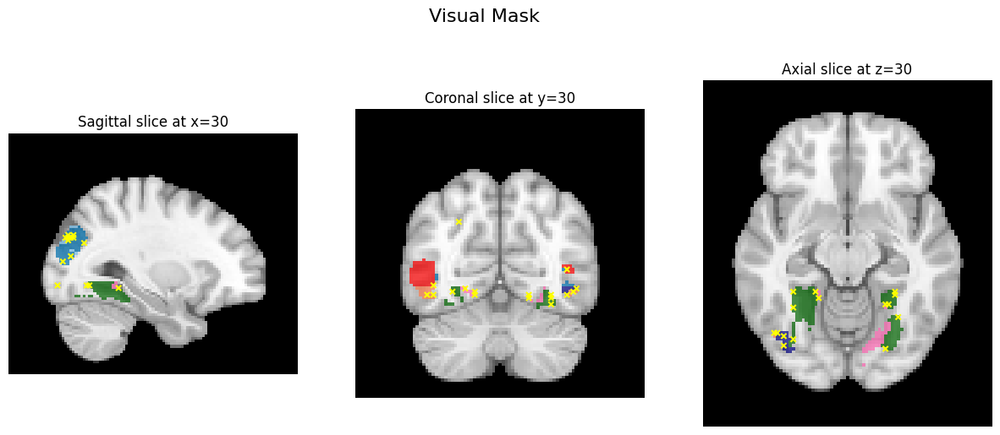

...

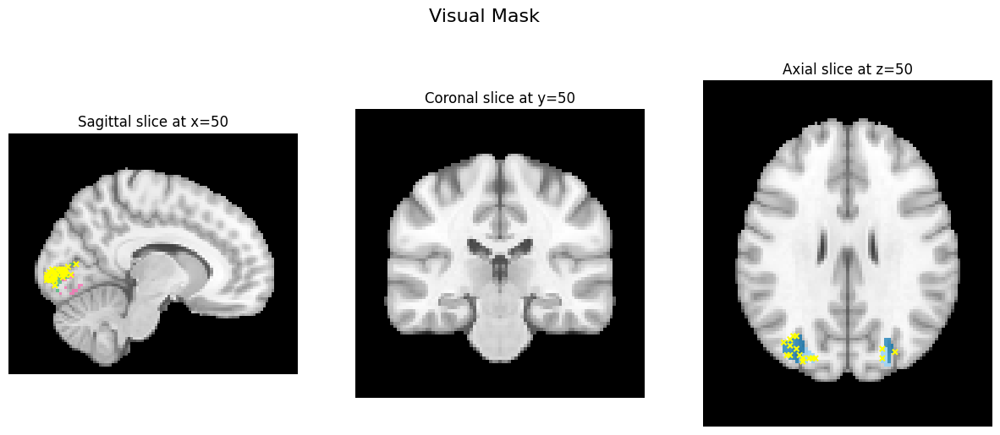

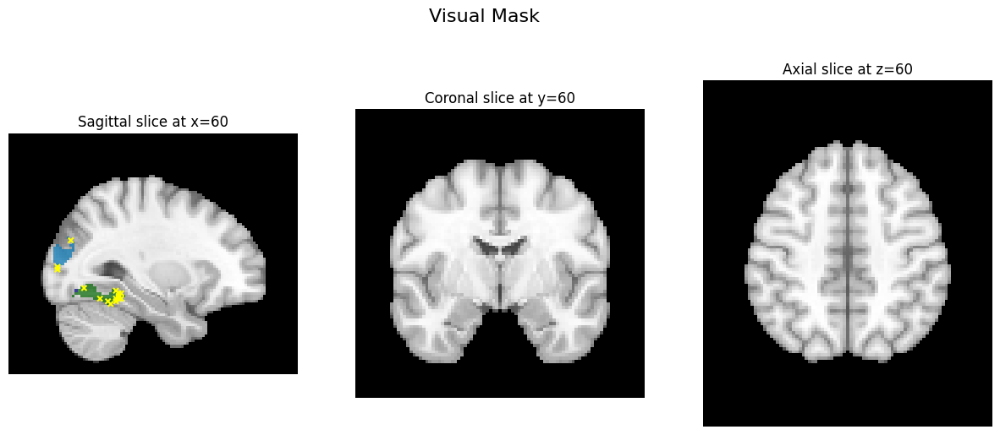

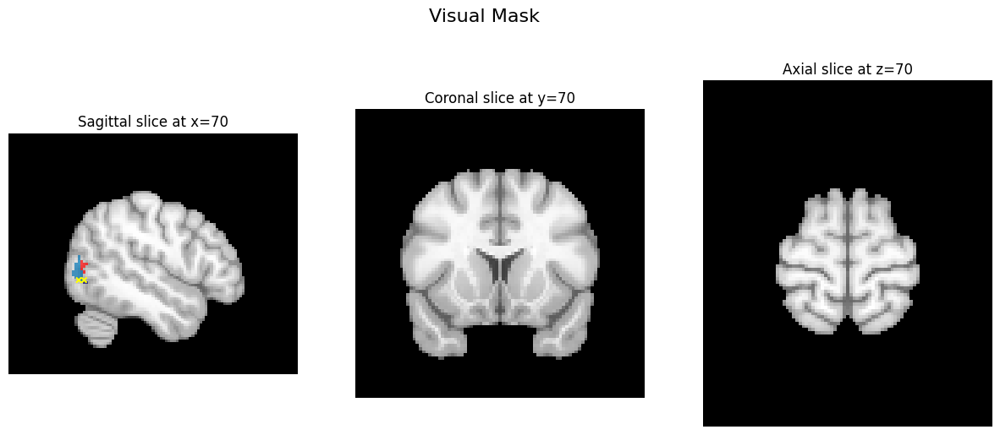

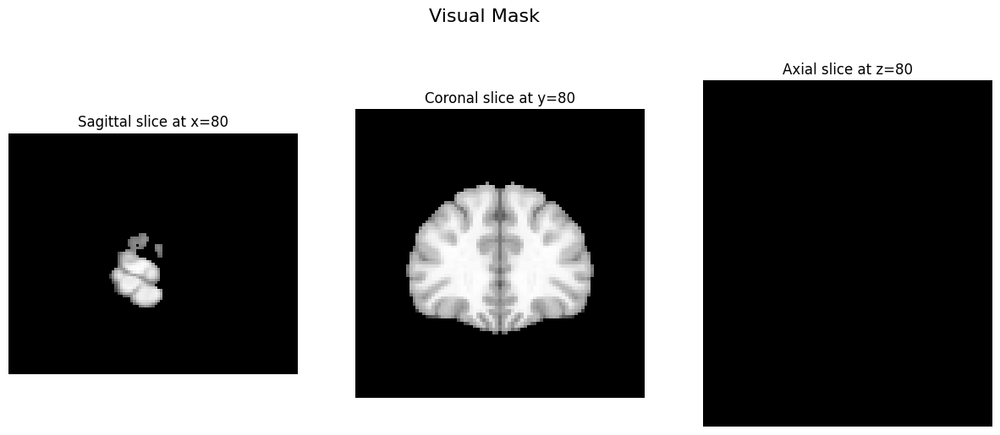

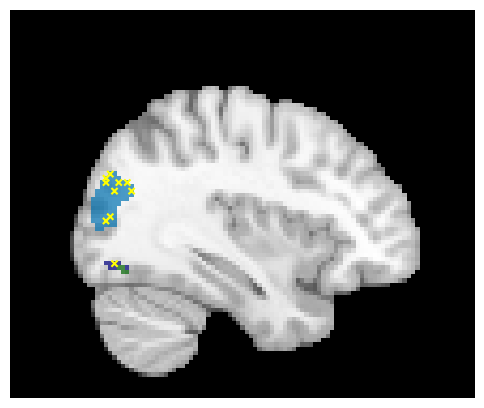

Sagittal slice at x=27


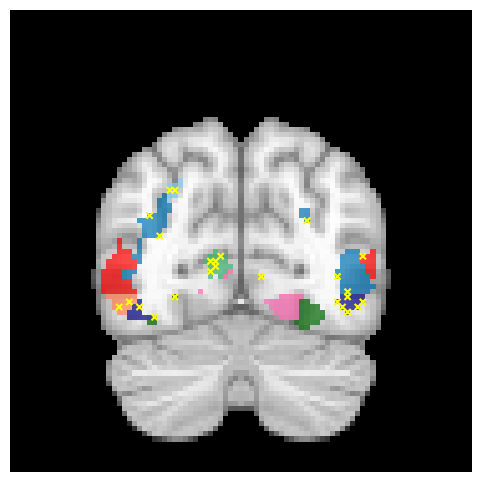

Coronal slice at y=27


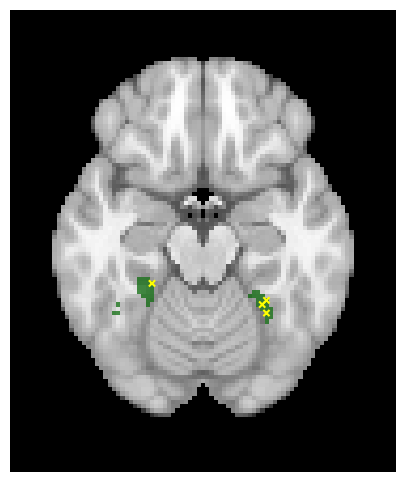

Axial slice at z=27


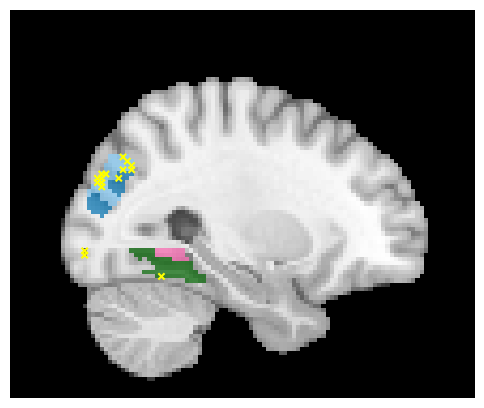

Sagittal slice at x=31


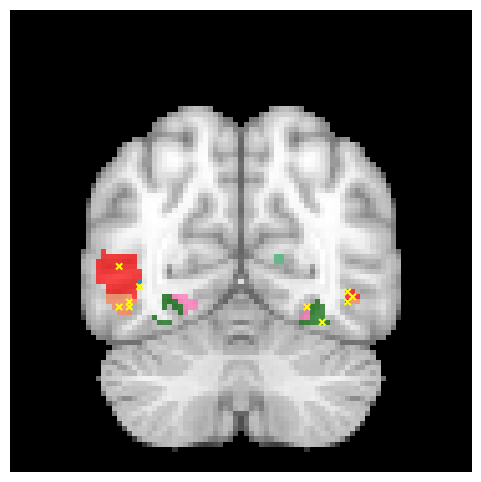

Coronal slice at y=31


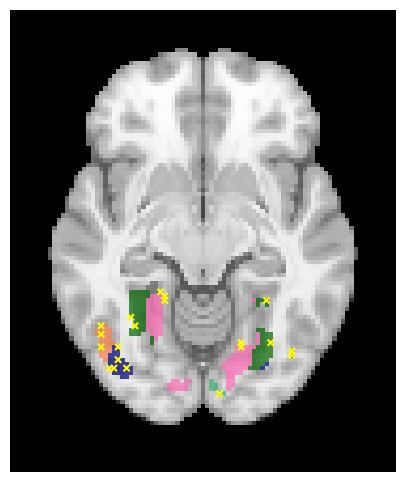

Axial slice at z=31


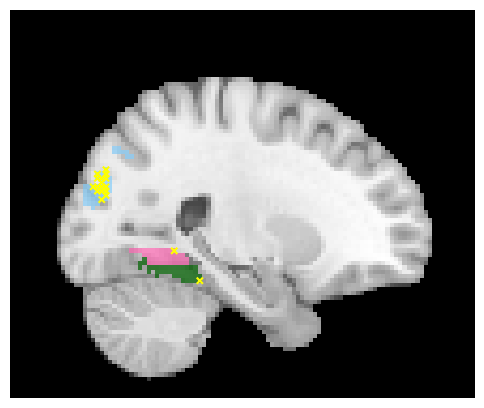

Sagittal slice at x=33


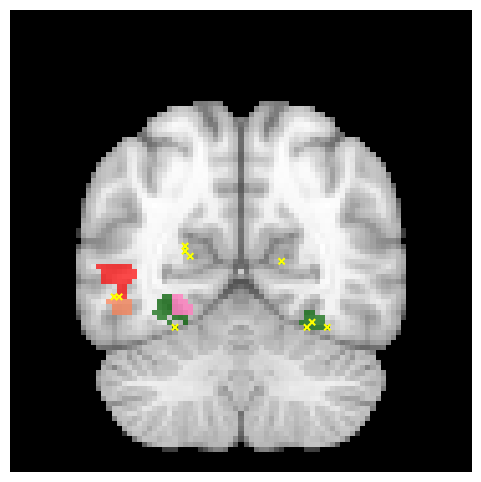

Coronal slice at y=33


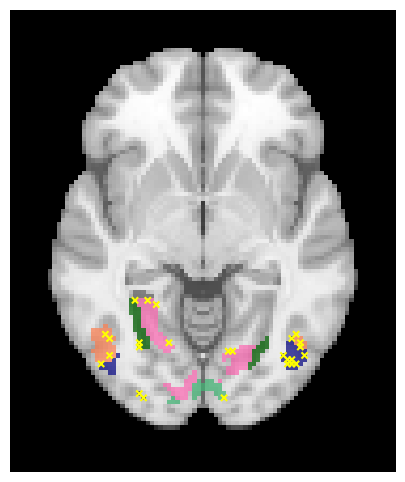

Axial slice at z=33
Testing completed. Total time: 2.94 minutes
---
encoder_predictions
  Sintel (shape: (111, 4609))
  Payload (shape: (155, 4609))
  TearsOfSteel (shape: (91, 4609))
  Superhero (shape: (158, 4609))
  BigBuckBunny (shape: (76, 4609))
  FirstBite (shape: (92, 4609))
  BetweenViewings (shape: (125, 4609))
  AfterTheRain (shape: (77, 4609))
  TheSecretNumber (shape: (121, 4609))
  Chatter (shape: (63, 4609))
  Spaceman (shape: (124, 4609))
  LessonLearned (shape: (103, 4609))
  YouAgain (shape: (613, 4609))
  ToClaireFromSonny (shape: (62, 4609))
decoder_predictions
  Sintel (shape: (111, 3, 112, 112))
  Payload (shape: (155, 3, 112, 112))
  TearsOfSteel (shape: (91, 3, 112, 112))
  Superhero (shape: (158, 3, 112, 112))
  BigBuckBunny (shape: (76, 3, 112, 112))
  FirstBite (shape: (92, 3, 112, 112))
  BetweenViewings (shape: (125, 3, 112, 112))
  AfterTheRain (shape: (77, 3, 112, 112))
  TheSecretNumber (shape: (121, 3, 112, 112))
  Chatter (shape: (63, 3, 112, 112))
  S

In [4]:
### model testing ###

# Testing parameters
test_input = testset['videos']
test_label = testset['fMRIs']
statistical_testing = False

state_dict = torch.load(save_model_as)
model.load_state_dict(state_dict)

# Testing loop
results = test_model(test_input, test_label, model, criterion, device, pretrained_decoder, model_to_train, statistical_testing, display_plots)
#save_data('encoder_decoder_performance.xlsx', results['test_performance'], save_model_as, mask_size, num_epochs, lr, encoder_weight)
print_dict_tree(results)

--------

# 2. Pipeline to preprocess the data and store it into train/val/test sets.

Please be careful when running the following cells, as it might **OVERWRITE** already existing masks and folders.

Note: the full thought process behind the mask generation can be found in "Schaefer 1000 mask.ipynb".

In [ ]:
### data preprocessing ###

# get_schaefer1000_mask(save_as='mask_schaefer1000_15364') # creates a mask of the visual cortex (shape of (15364,))
# store_masked_fMRI(mask_path = 'mask_schaefer1000_15364.npy', main_folder = 'fMRIs_schaefer1000_15364') # stores fMRI data with the mask applied

# get_snr_mask(percentile = 70) # creates a mask containing the top 30% voxels with highest SNR across movies among the 15364 voxels in the previous mask
                                # the mask is saved as "mask_schaefer1000_####" where #### is the number of selected voxels (4609 voxels if percentile = 70)
# store_masked_fMRI(mask_path = 'mask_schaefer1000_####.npy', main_folder = 'fMRIs_schaefer1000_####') # stores fMRI data with the mask applied

# store_processed_videos() # processes and stores the videos of interest. please modify paths directly in the function definition

In [ ]:
### data spliting ###

split_for_encoder(dataset_ID = 0000, test_size = 0.2, fMRIs_path = 'fMRIs_schaefer1000_4609', full_movie_test = 'YouAgain')
      # creates a folder "encoder_dataset_####" splitted into train, test, and validation sets